# Install libraries

In [ ]:
!pip install llama-parse
!pip install graphlit-client
!pip install python-Levenshtein
!pip install matplotlib
!pip install pdf2image

# Load libraries

In [4]:
import os
import time
import nest_asyncio
nest_asyncio.apply()
from llama_parse import LlamaParse
from graphlit_client import Graphlit
from Levenshtein import ratio
from IPython.display import display, HTML
import base64
from pdf2image import convert_from_path
from io import BytesIO


# Set and download and a sample file

In [64]:
file_uri="https://drive.google.com/file/d/1ZI0_Xcqbw5BtjZ0IavLTbnEZ_ia858YJ/view?usp=sharing"
file_path="./uber_10q_march_2022_1page.pdf"

In [44]:
# Configurations
UNSTRUCTED_API_URL="https://XXXXX.api.unstructuredapp.io/general/v0/general"
UNSTRUCTED_API_KEY="PxXXXX"
GRAPHLIT_ENV_ID="6XXXX"
GRAPHLIT_ORG_ID="fXXXX"
GRAPHLIT_SECRET_KEY="srXXXX"
LLAMA_PARSE_KEY="llx-XXXXX"

# Load with UnstructedAPI

In [45]:
import requests

url = UNSTRUCTED_API_URL

def unstructured_api_request(file_path):
  payload = {'strategy': 'hi_res', 'pdf_infer_table_structure': 'true'}
  files=[
    ('files',(file_path,open(file_path,'rb'),'application/pdf'))
  ]
  headers = {
    'accept': 'application/json',
    'unstructured-api-key': UNSTRUCTED_API_KEY
  }

  response = requests.request("POST", url, headers=headers, data=payload, files=files)
  unstructured_api_result = response.json()

  f = open(f"{file_path}_unstruct_result.txt", "a")
  for data in unstructured_api_result:
    f.write(f"{data['text']}\n")
  f.close()

unstructured_api_request(file_path)

# Load with Graphlit

In [57]:
def ingest_file(uri):
    # Define the GraphQL mutation
    mutation = """
    mutation IngestPage($uri: URL!, $isSynchronous: Boolean) {
        ingestPage(uri: $uri, isSynchronous: $isSynchronous) {
            id
            markdown
            document {
                title
                keywords
                author
                pageCount
            }
        }
    }
    """
    # Define the variables for the mutation
    variables = {
        "isSynchronous": True, # wait for content to be ingested
        "uri": uri
    }
    # Convert the request to JSON format
    response = client.request(query=mutation, variables=variables)
    print(response)
    if 'errors' in response and len(response['errors']) > 0:
        error_message = response['errors'][0]['message']
        return error_message

    content_data = response['data']['ingestPage']['markdown']
    return content_data

client = Graphlit(environment_id=GRAPHLIT_ENV_ID,
                organization_id=GRAPHLIT_ORG_ID,
                secret_key=GRAPHLIT_SECRET_KEY)
graphlit_result_id = ingest_file(file_uri)
f = open(f"{file_path}_graphlit_result.txt", "w")
f.write(graphlit_result_id)
f.close()

# Load with LLama Parse

In [60]:
def llama_doc_parse(fileloc):
  parser = LlamaParse(
    api_key=LLAMA_PARSE_KEY,  # can also be set in your env as LLAMA_CLOUD_API_KEY
    result_type="text",  # "markdown" and "text" are available
    num_workers=4, # if multiple files passed, split in `num_workers` API calls
    verbose=True,
    language="en" # Optionaly you can define a language, default=en
  )
  # sync
  documents = parser.load_data(fileloc)
  return documents

llama_doc_parse_result = llama_doc_parse(file_path)
f = open(f"{file_path}_llama_result.txt", "w")
f.write(llama_doc_parse_result[0].text)
f.close()

# File Sample Compare

In [47]:
# Convert the first page image to a format that can be displayed in HTML
def img_to_base64(img):
    buffered = BytesIO()
    img.save(buffered, format="JPEG")
    img_str = base64.b64encode(buffered.getvalue()).decode("utf-8")
    return f"data:image/jpeg;base64,{img_str}"

# Function to read and return the content of a text file
def read_text_file(file_path):
    with open(file_path, 'r') as file:
        return file.read()
    
def compare_pdf_extraction(pdf_file, txt_file, title):
    # Convert PDF to list of images
    pages = convert_from_path(pdf_file, dpi=200)
    
    # Read the content of your text file
    text_content = read_text_file(txt_file)

    # Get the base64 string for the first page image
    img_base64 = img_to_base64(pages[0])

    # Create HTML layout for displaying the text and the image side by side
    html_content = f"""
    <h2>{title}</h2>
    <div style="display: flex; width: 100%; align-items: flex-start;">
        <div style="flex: 1; max-width: 50%;">
            <img src="{img_base64}" style="max-width: 100%; height: auto;">
        </div>      
        <div style="flex: 1; margin-right: 20px; max-width: 50%; overflow: auto; white-space: pre-wrap;">
            {text_content}
        </div>
    </div>
    """

    # Display the combined HTML
    display(HTML(html_content))


# Sample 1 


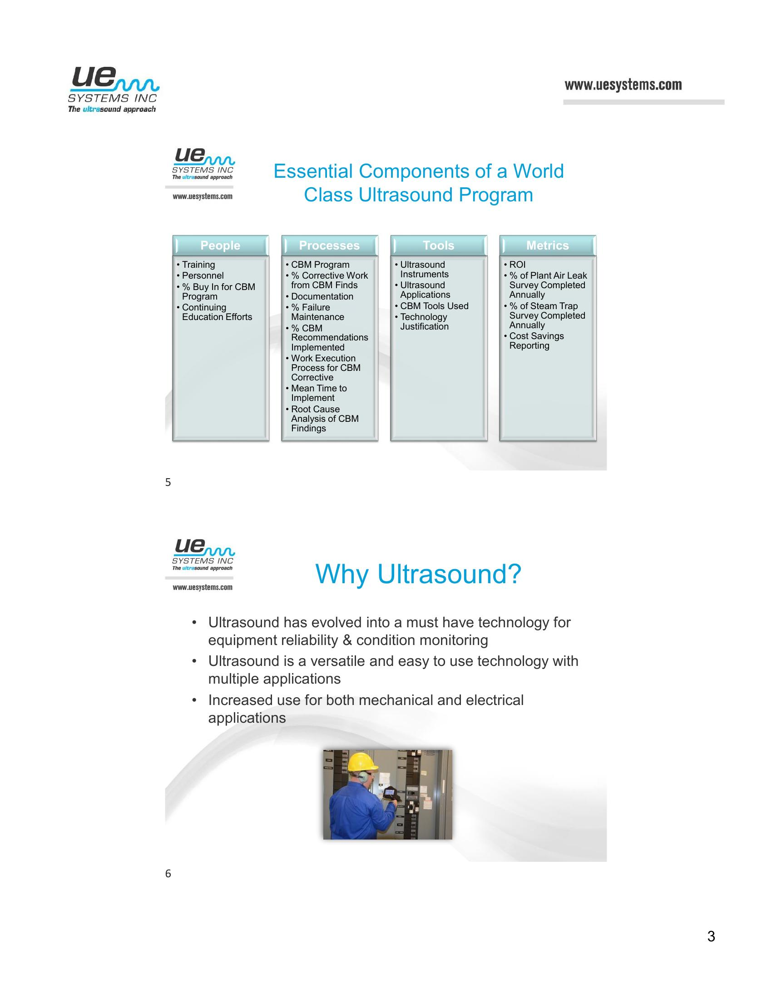


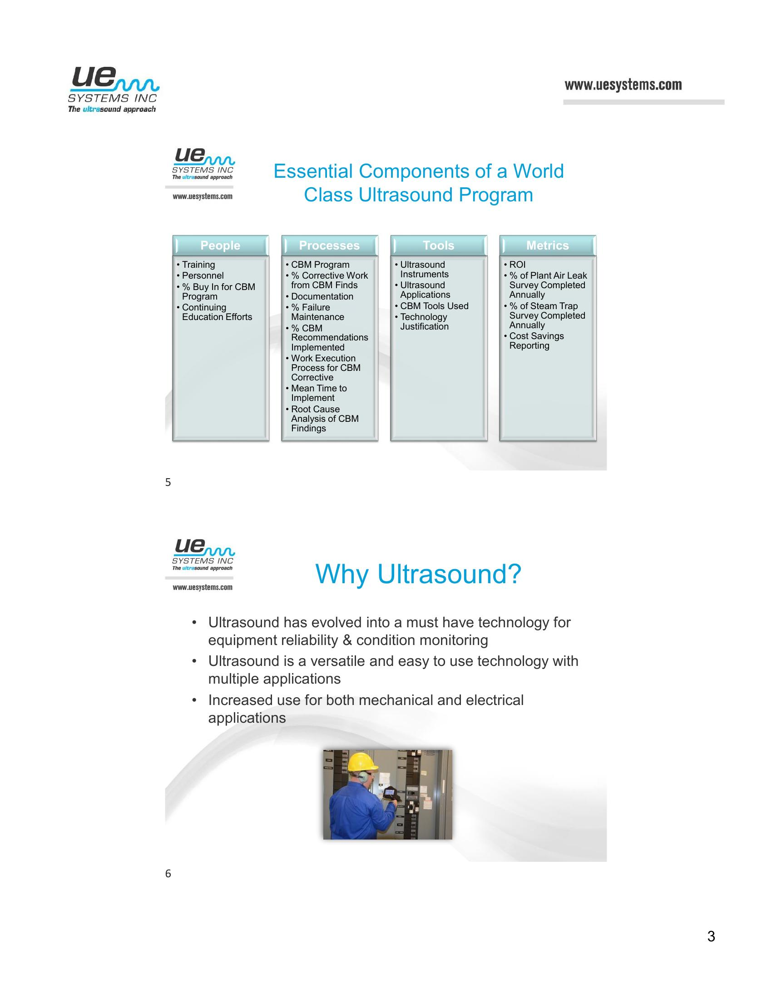


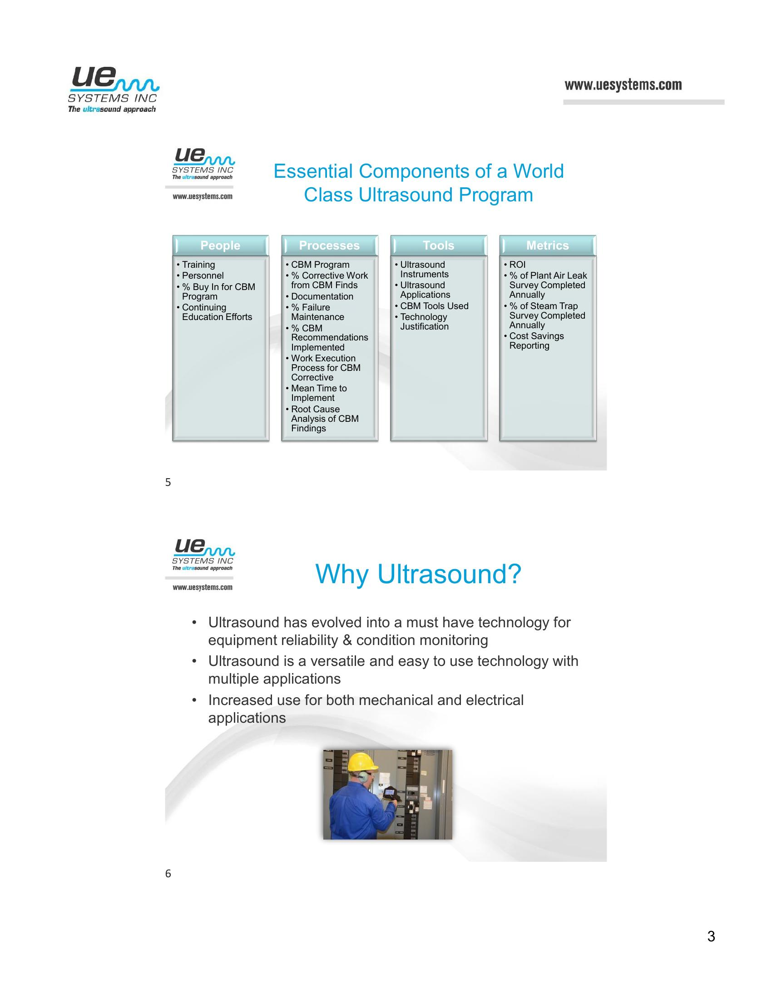

In [48]:
file=1
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

- Unstructed has multiple occurance of the row information and could not extracted image from text completely. 
- Llama parse has maintained the structrue of the table in pdf as upto a certain point and extracted text from the image accurately. 
- Graphlit also maintanied the structure of the table in pdf making columns in new lines and maintaining the row information. However missed to extract the information from the image


# Sample 2


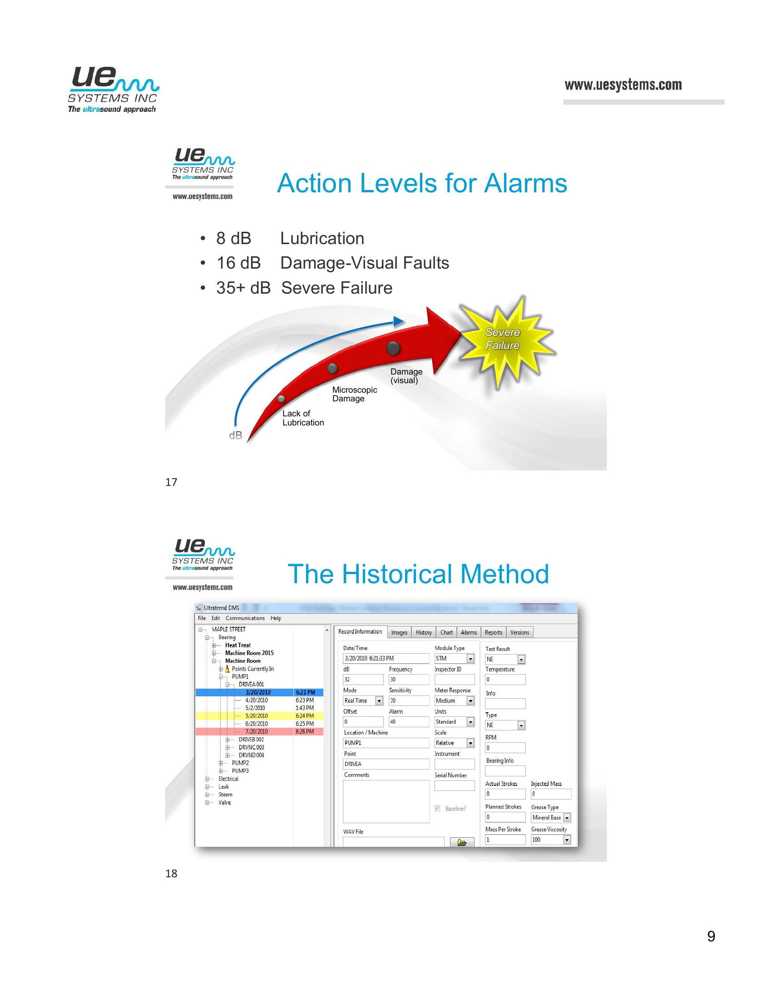


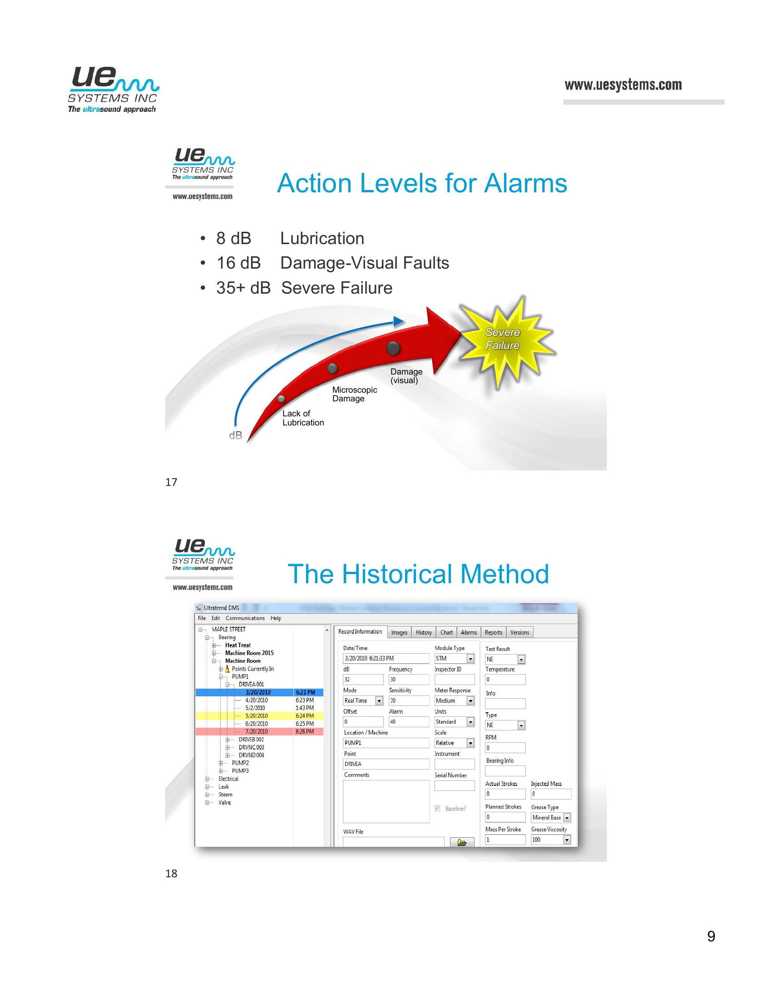


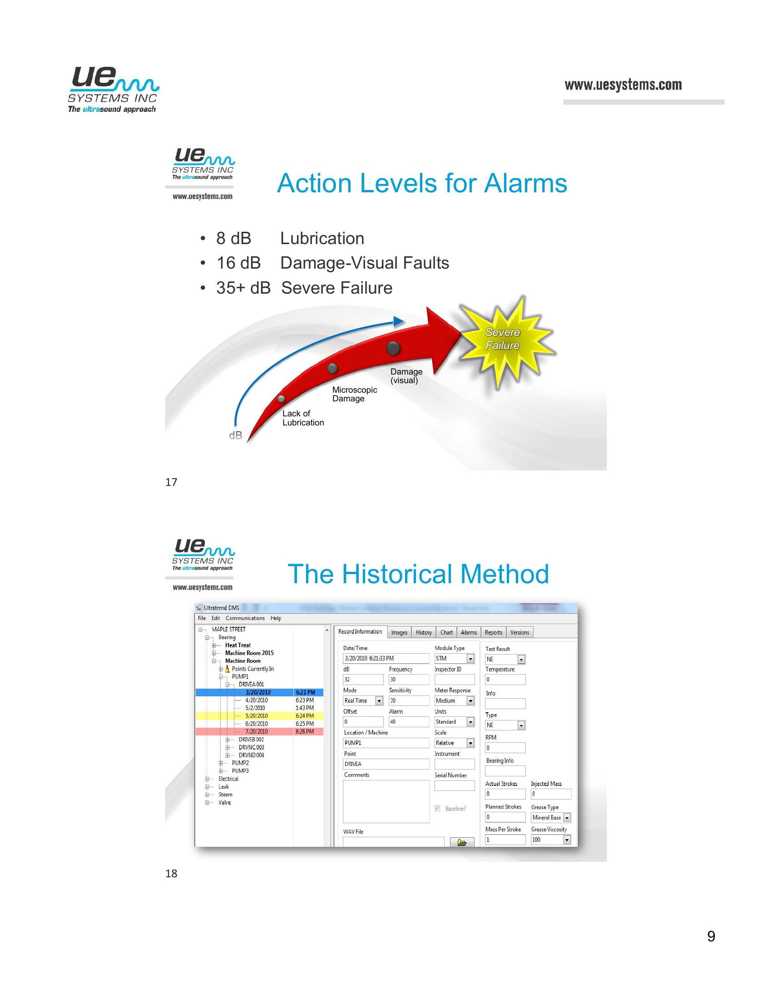

In [49]:
file=2
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

- Unstructure and LlamaParse both are able to extract text from images
- Graphlit is able to capture the plain text within the image

# Sample 3


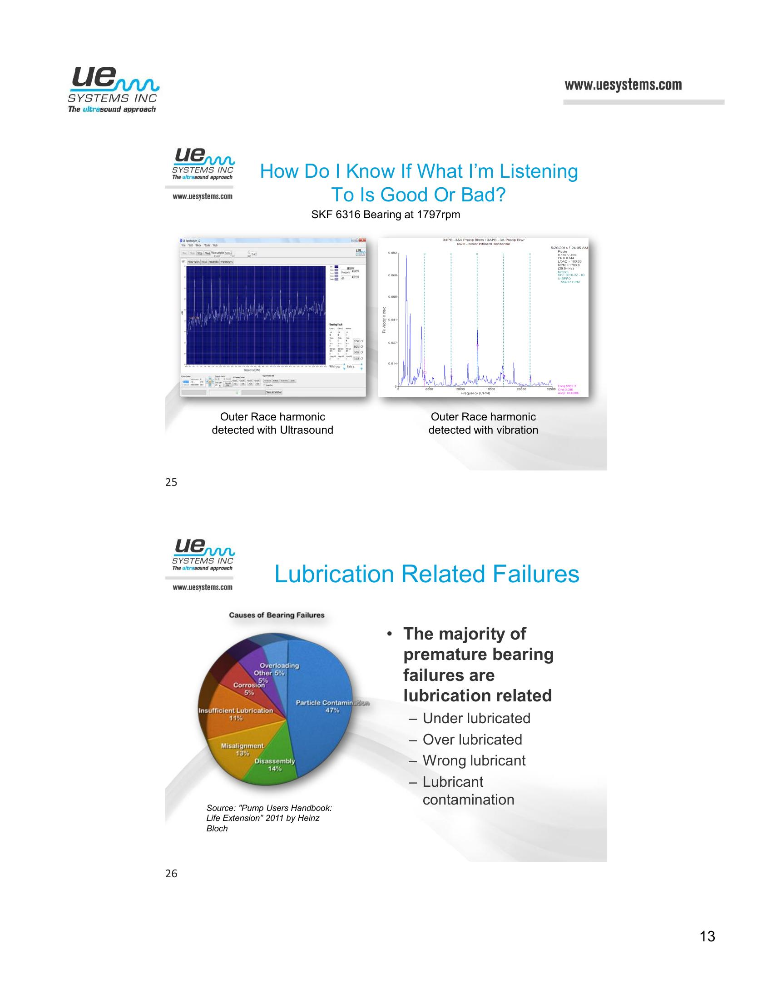


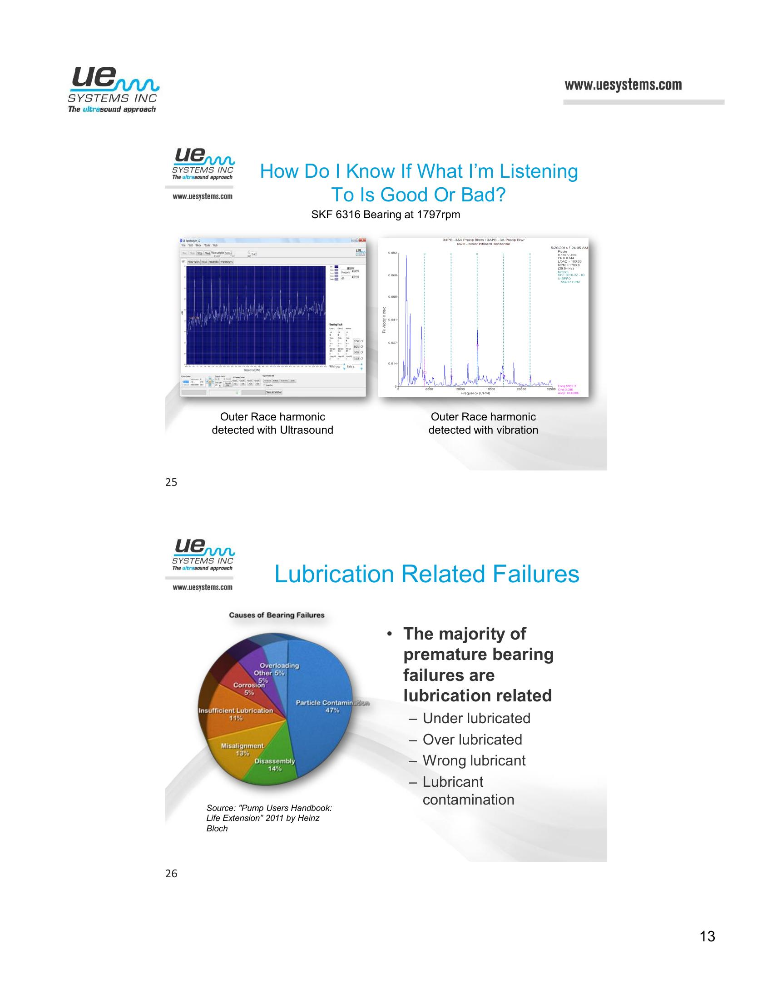


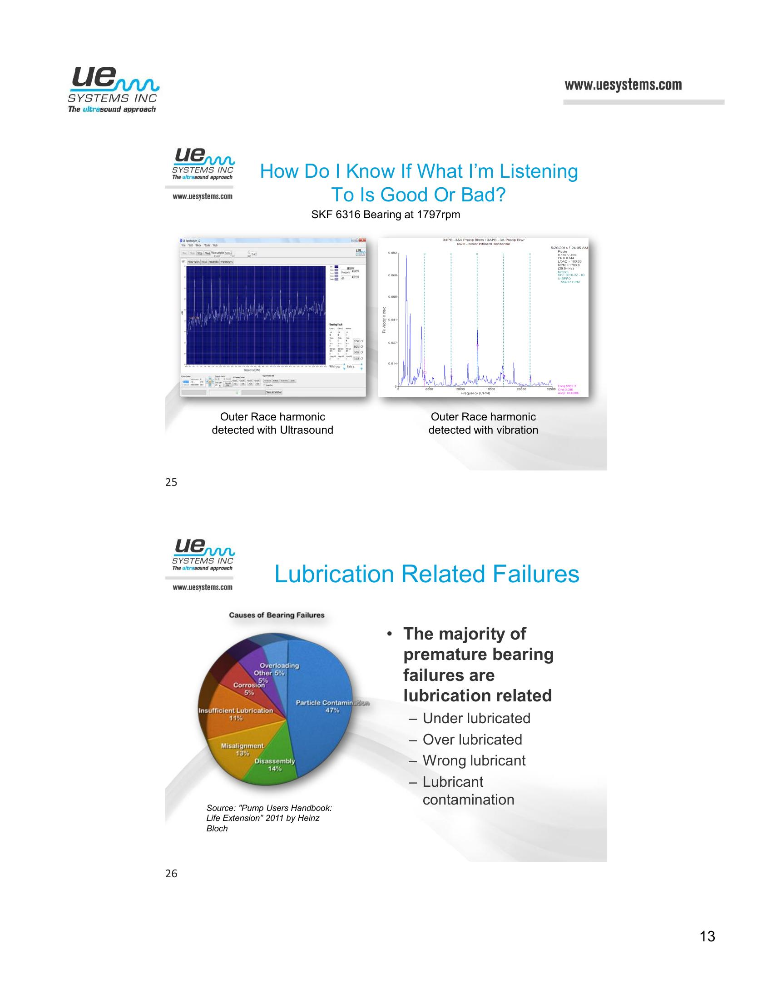

In [50]:
file=3
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

- LlamaParse was able to capture most of the text and was also good at capturing numerical percentage data.
- Unstructured gave some random characters and duplicated text
- Graphlit was able to capture most of the text not from the text within images

# Sample 4


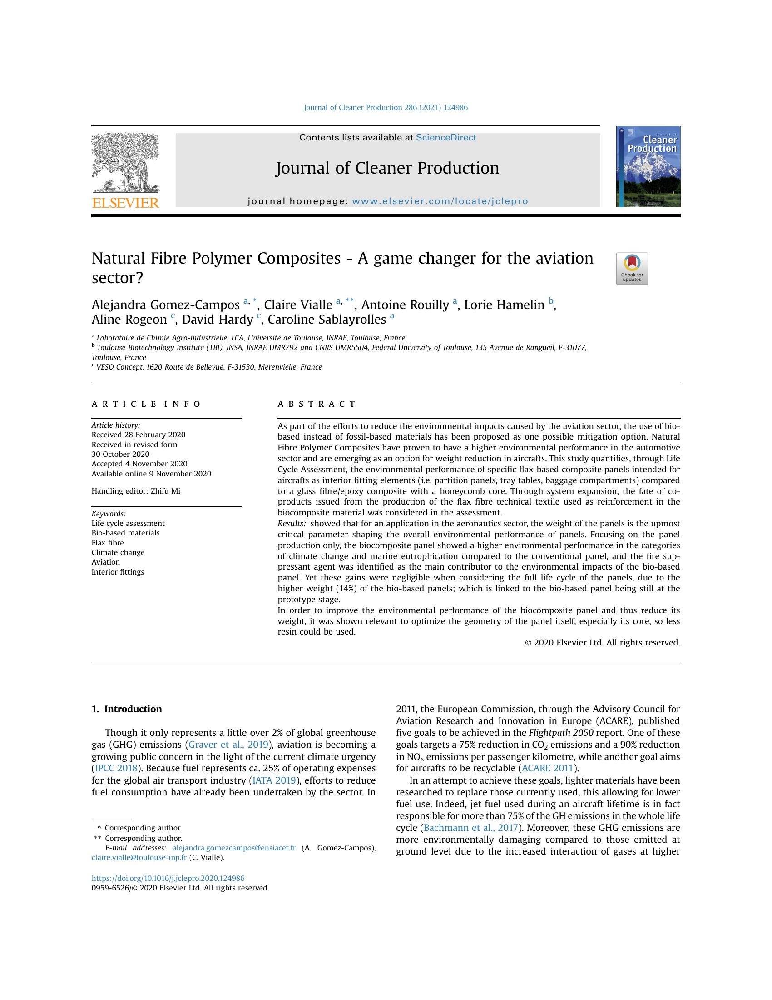


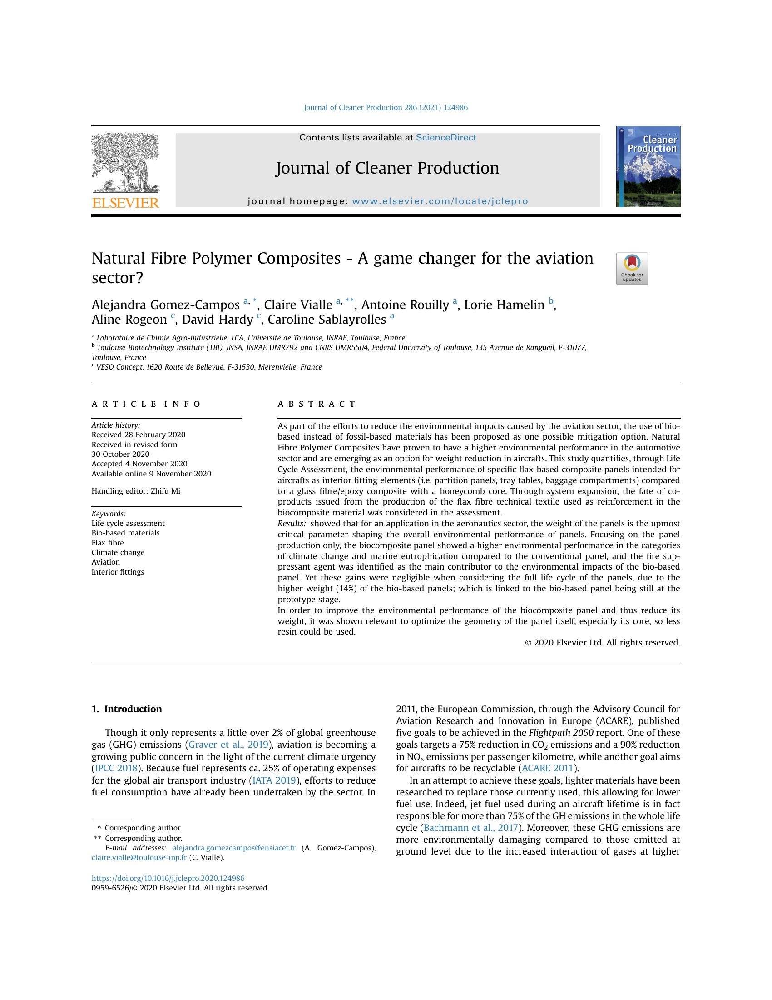


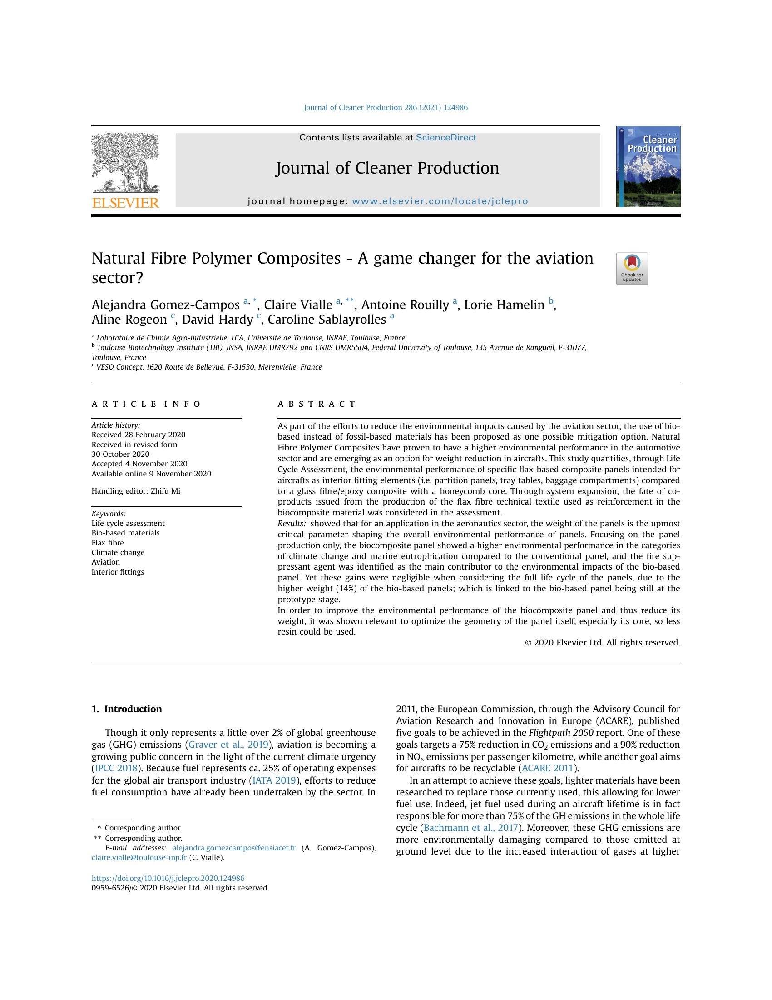

In [52]:
file=4
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

- The different sections of the textual data is taken care by the Unstructured and Graphlit.
- LlamaParse and Unstructured did captured the Header with some font difference and incorrect extraction.

# Sample 5


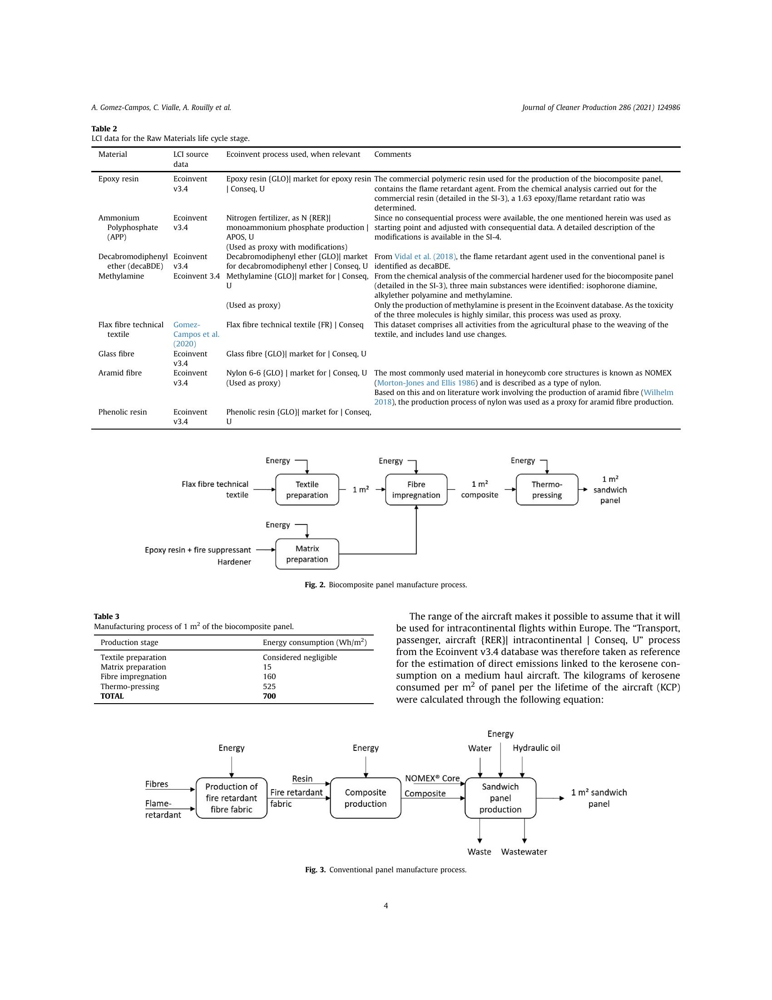


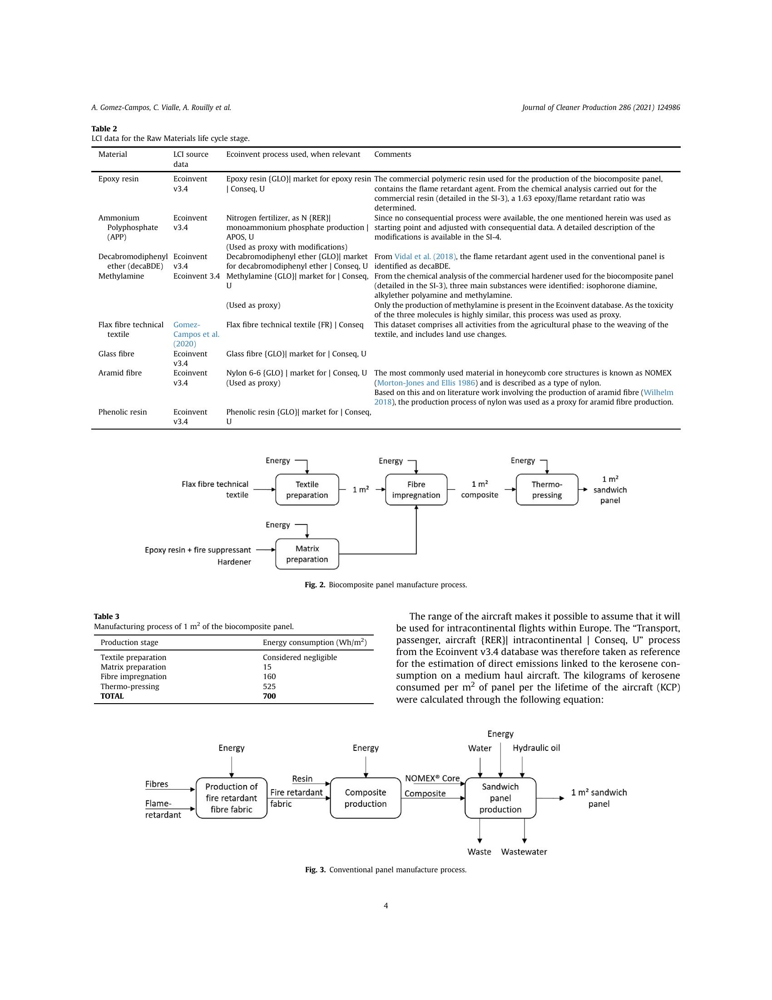


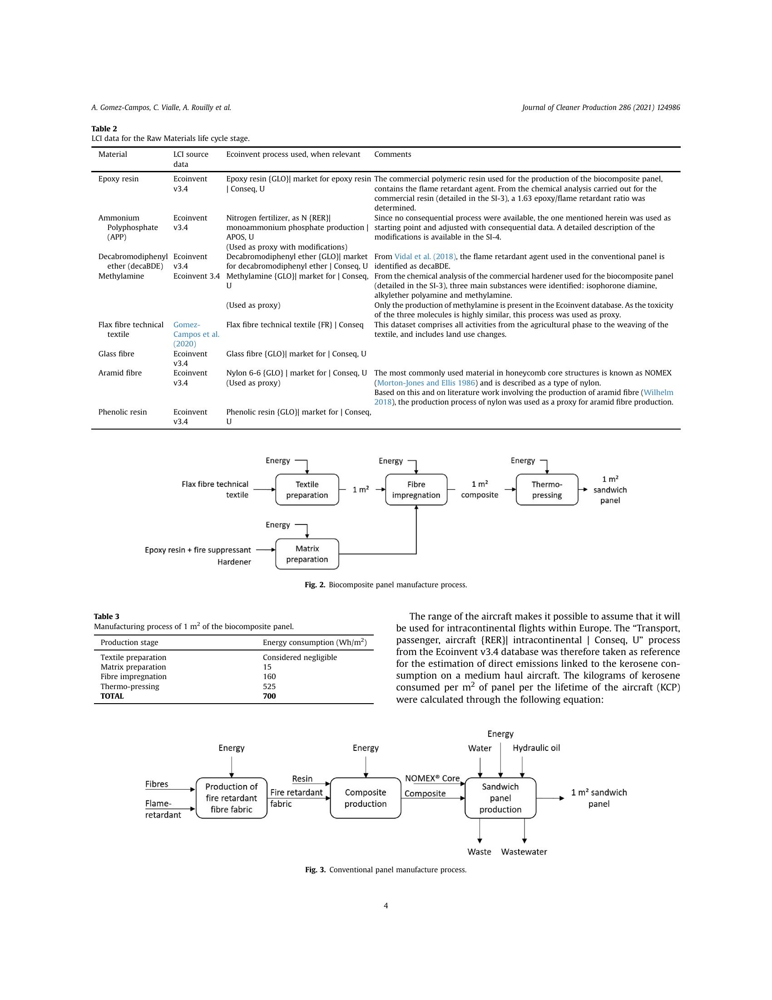

In [54]:
file=5
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 6


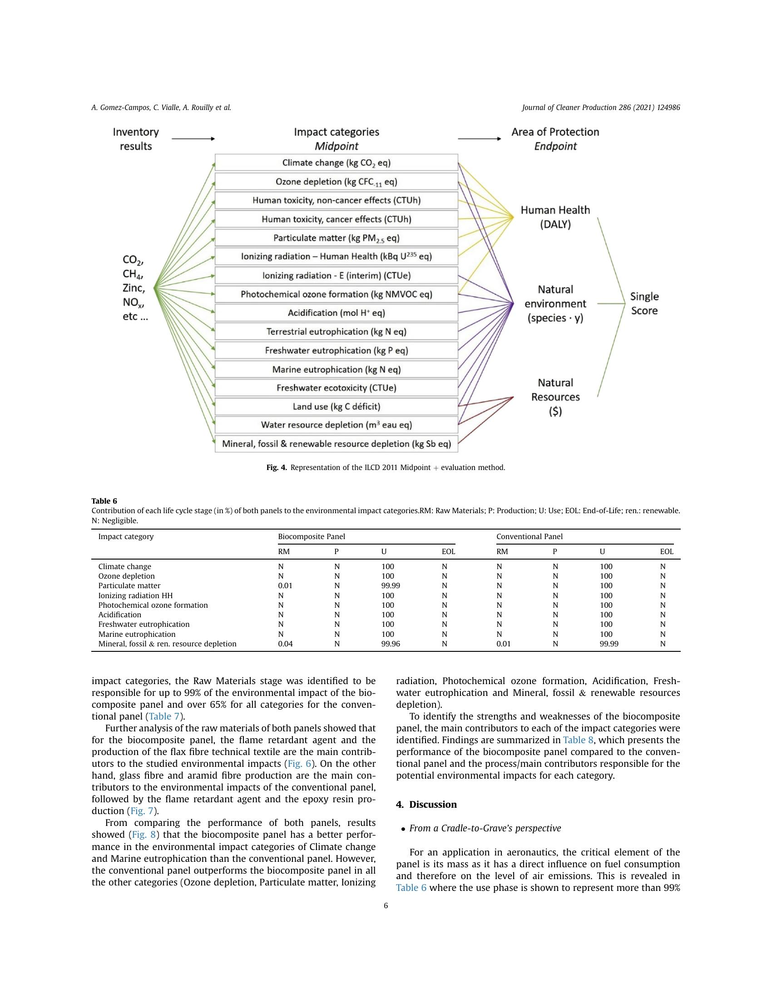


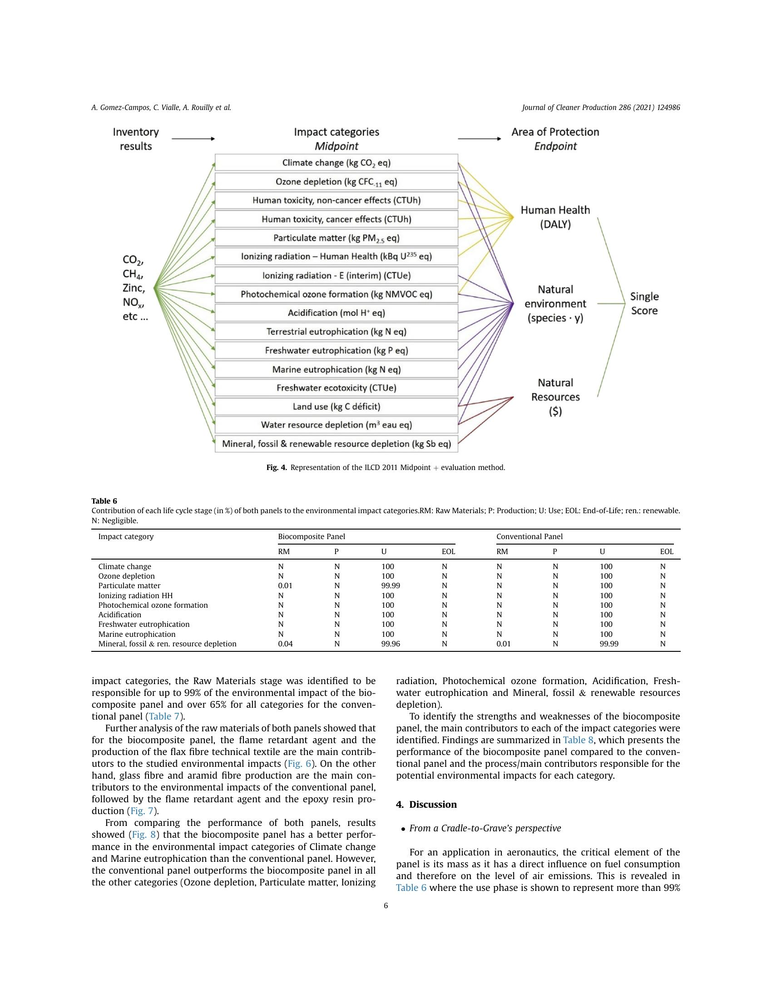


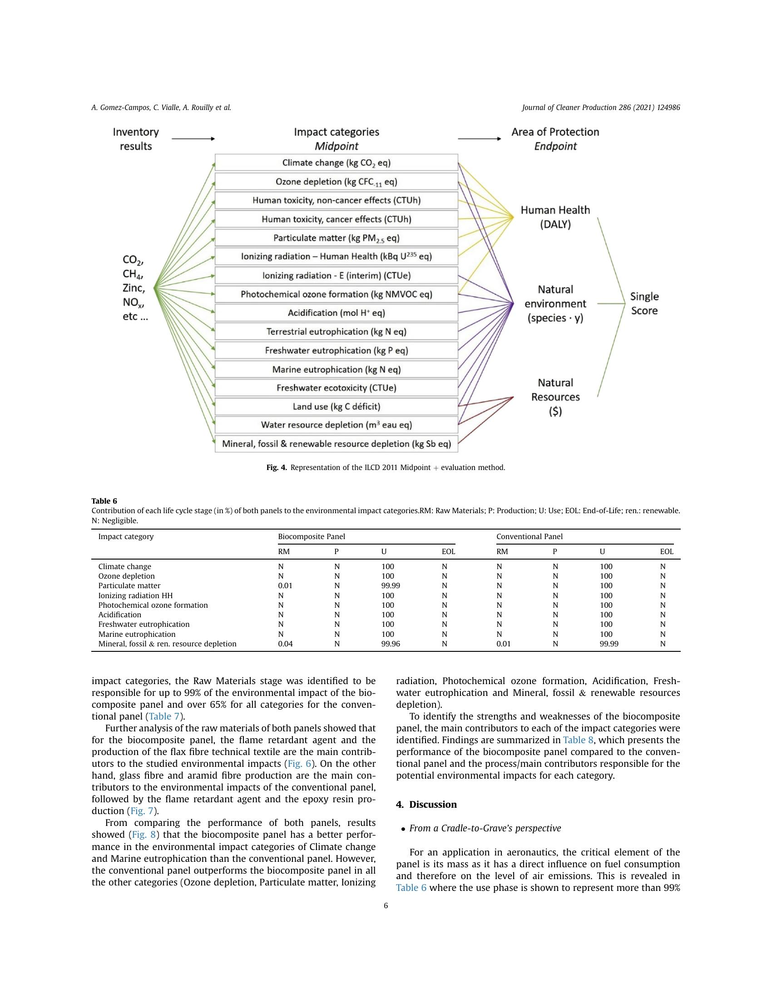

In [55]:
file=6
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 7


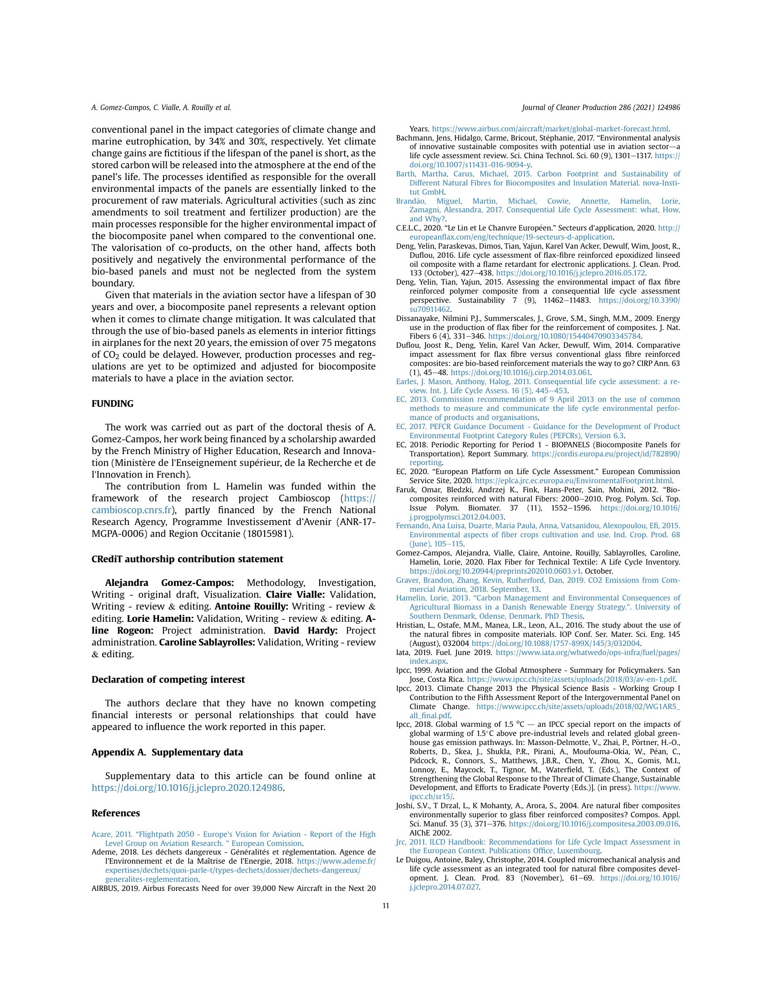


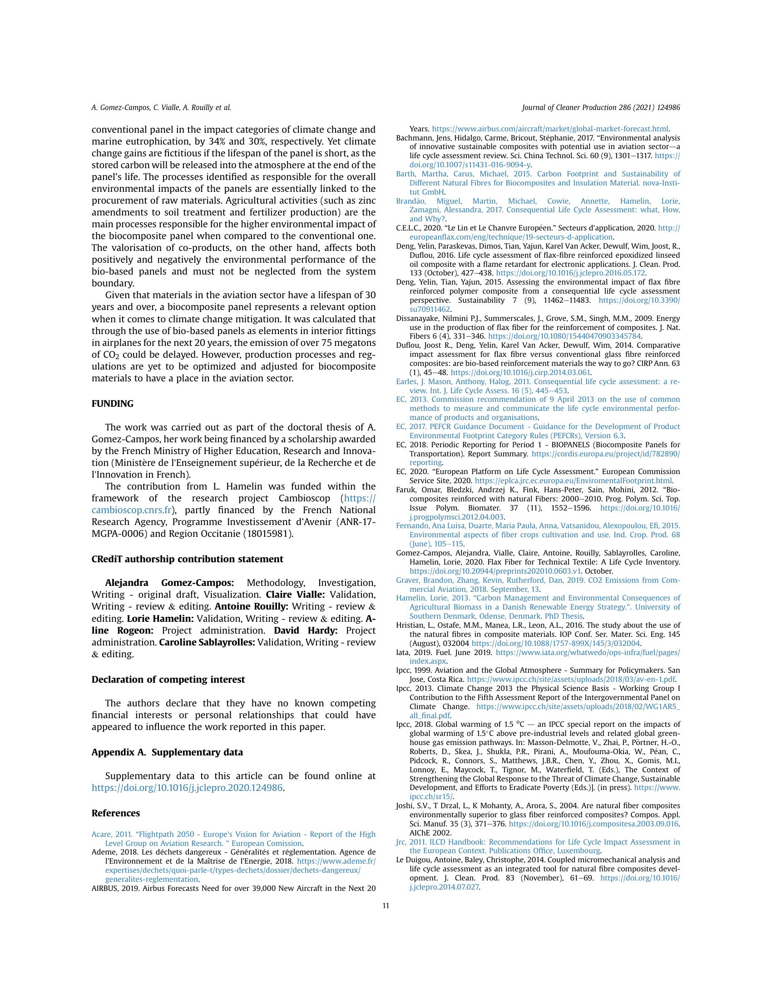


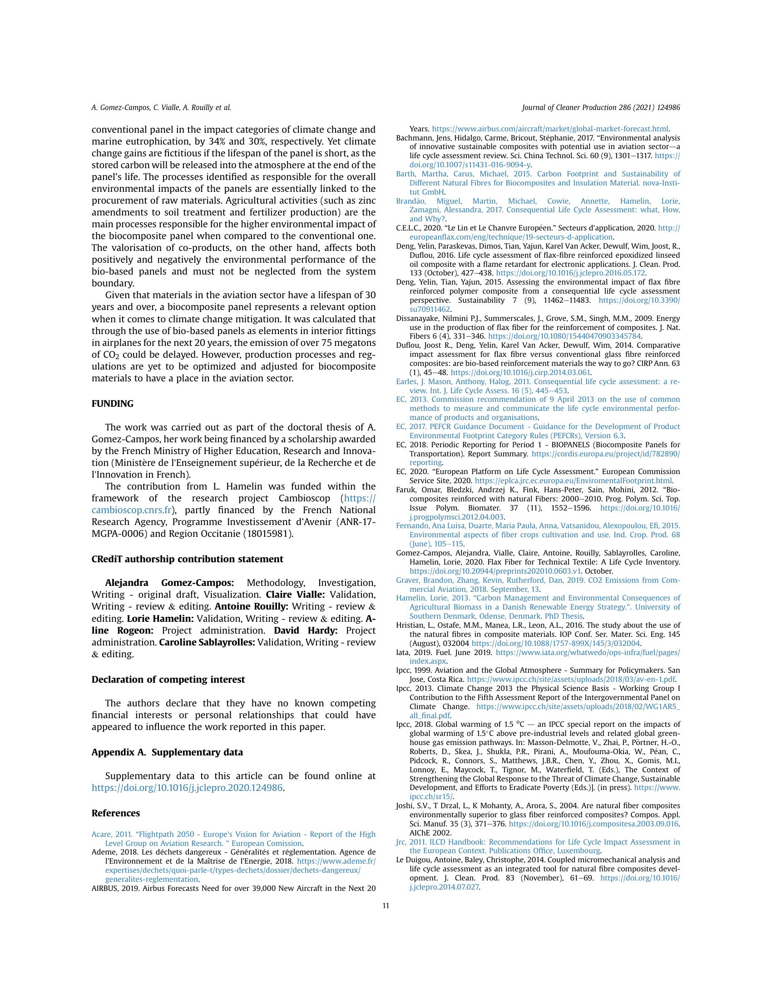

In [56]:
file=7
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Sample 8


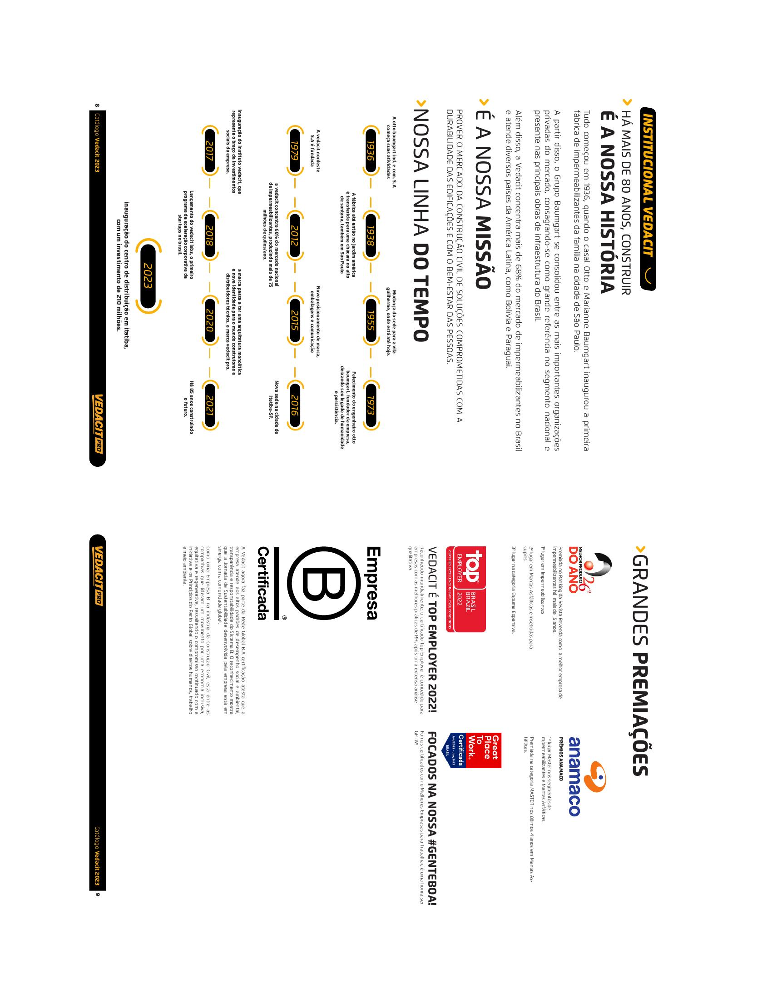


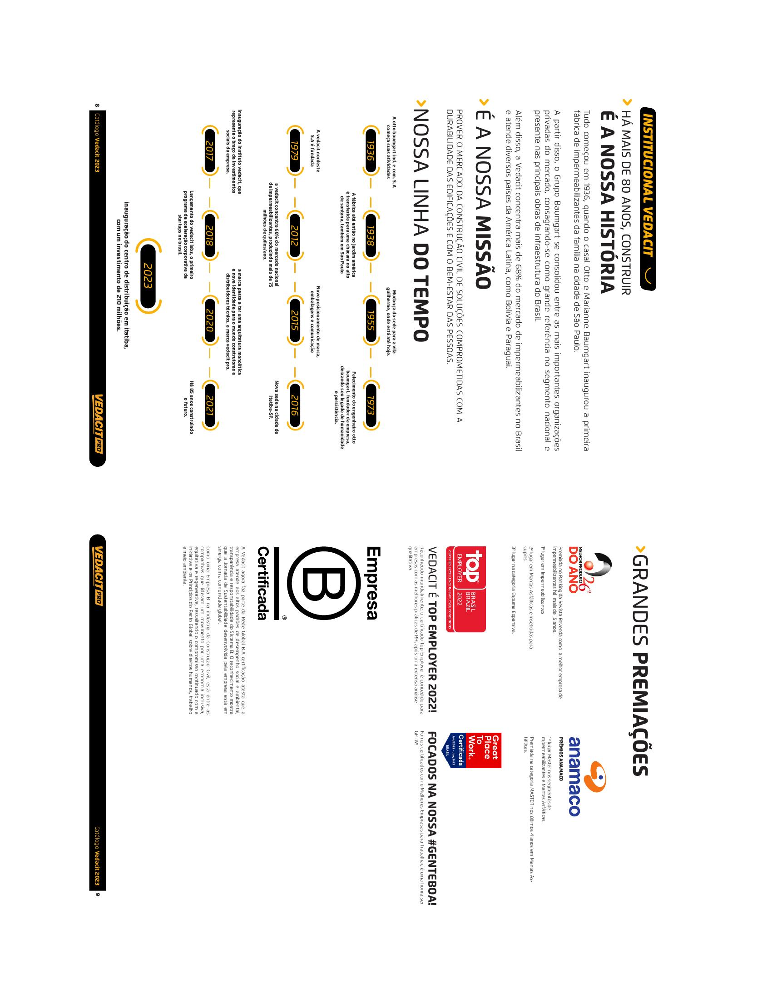


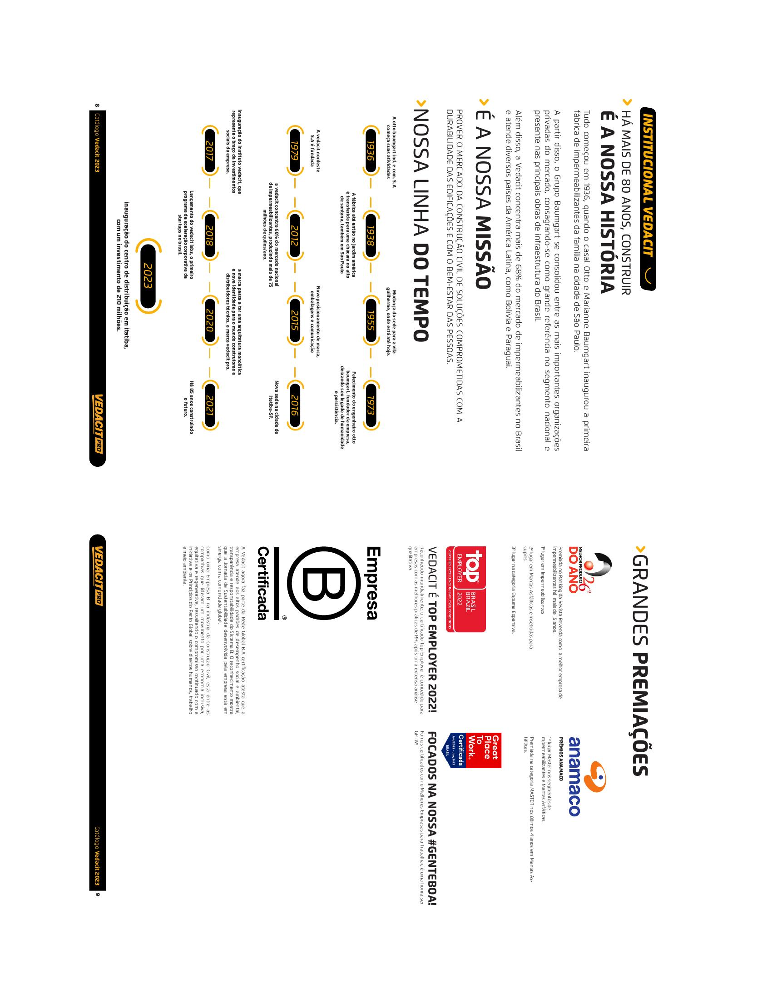

In [58]:
file=8
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 9


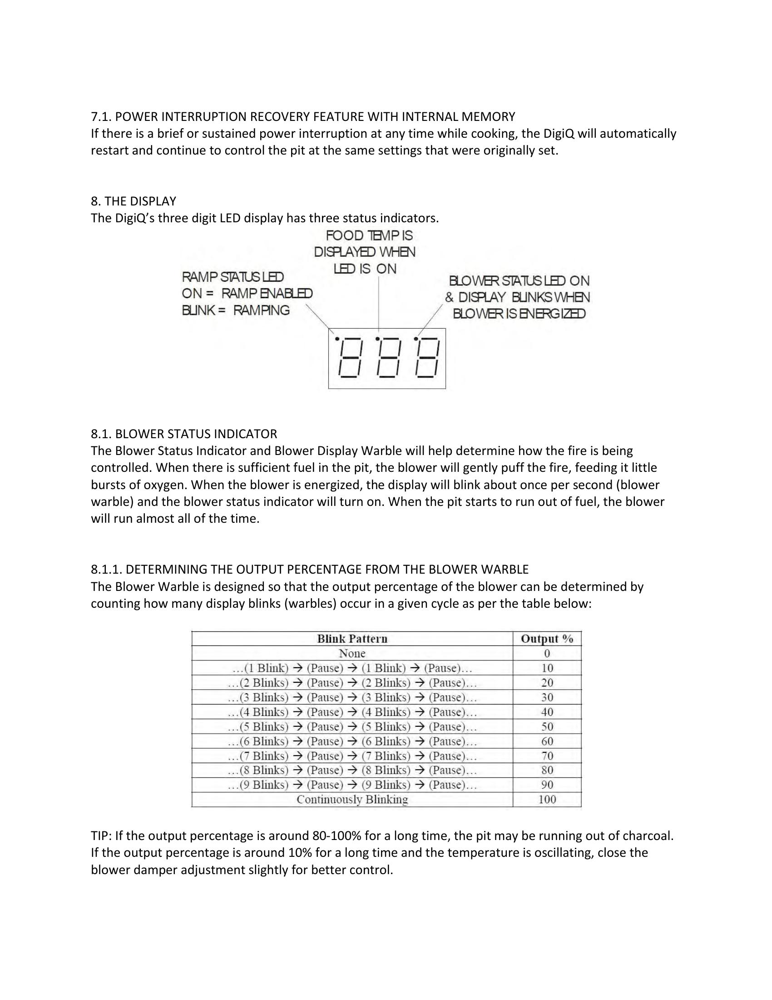


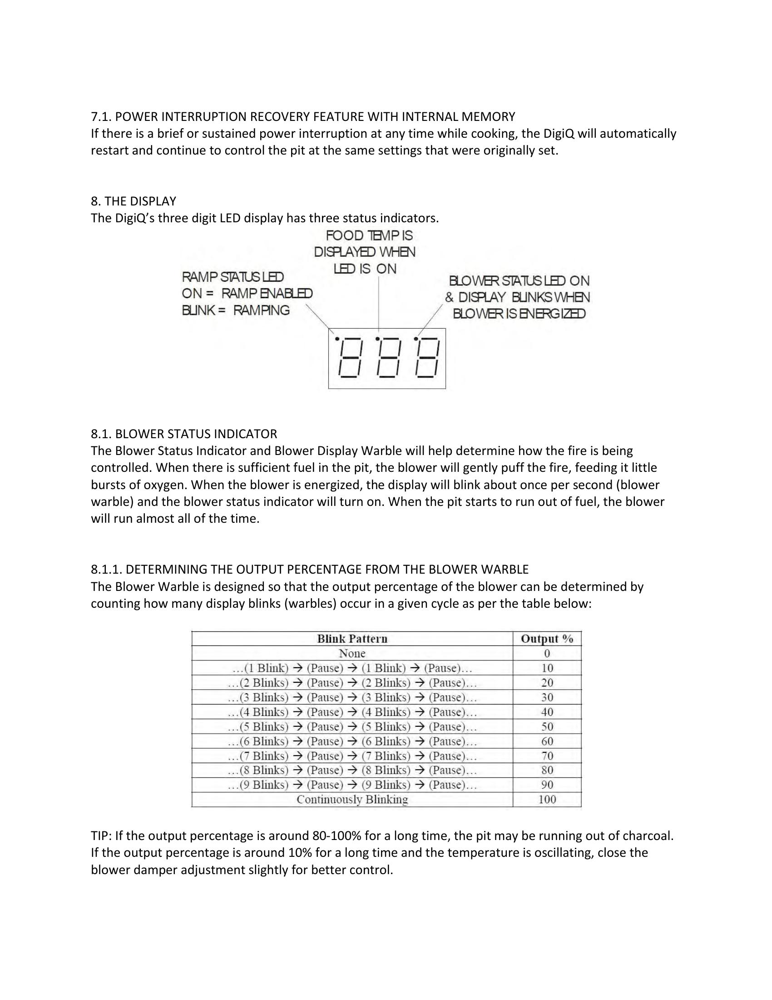


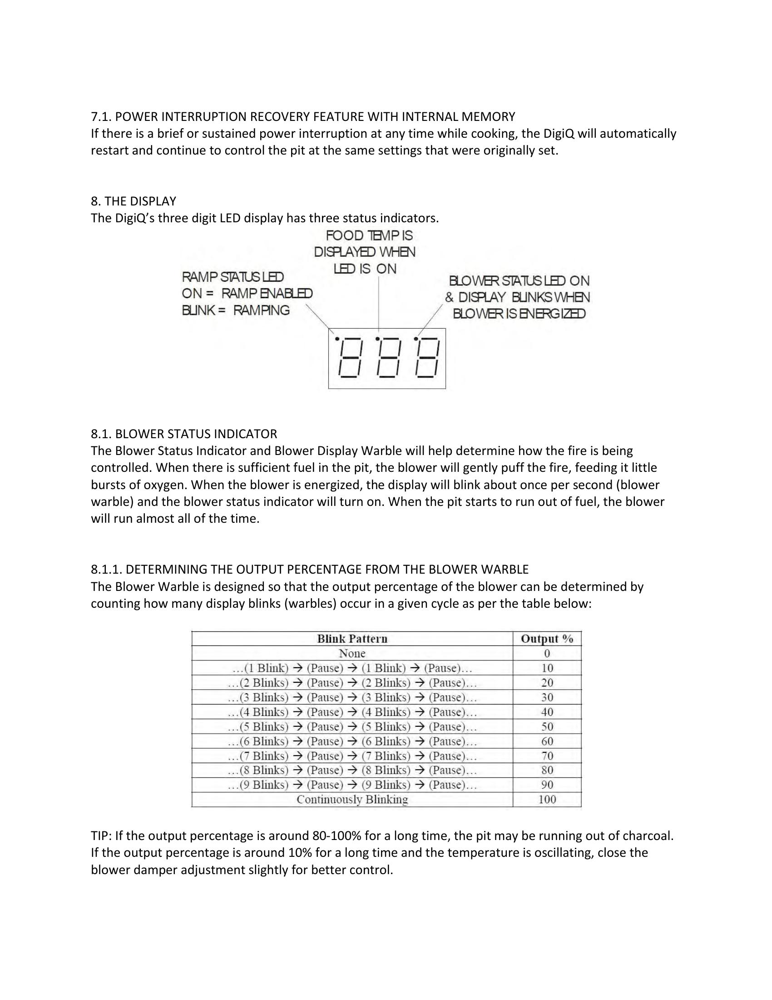

In [60]:
file=9
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 10


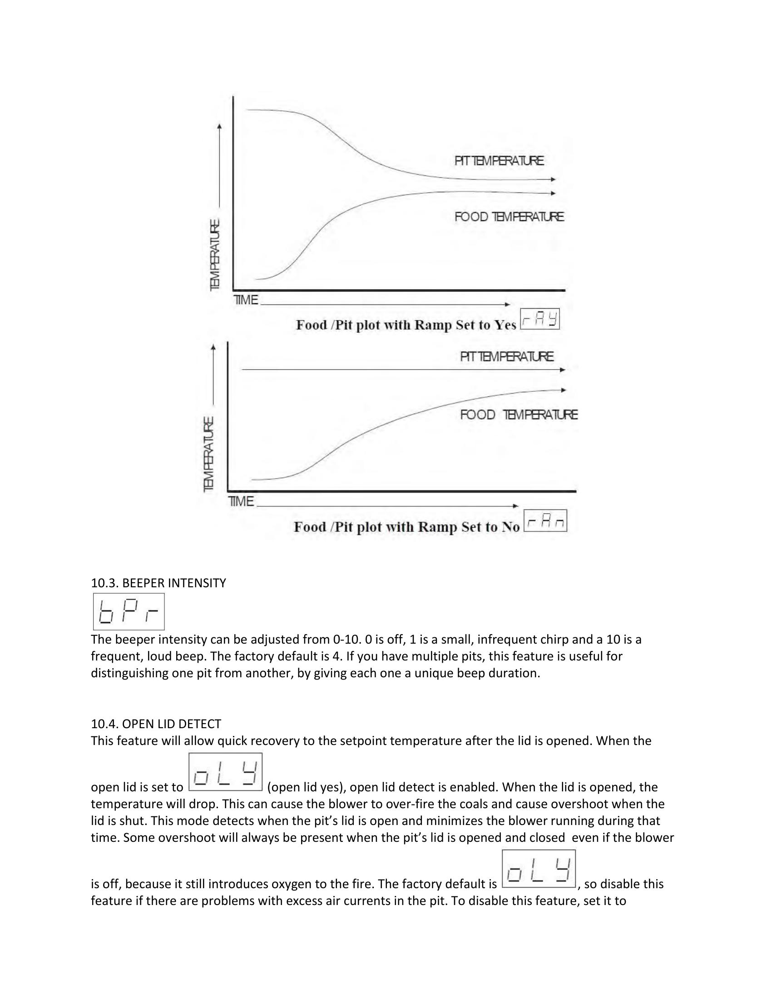


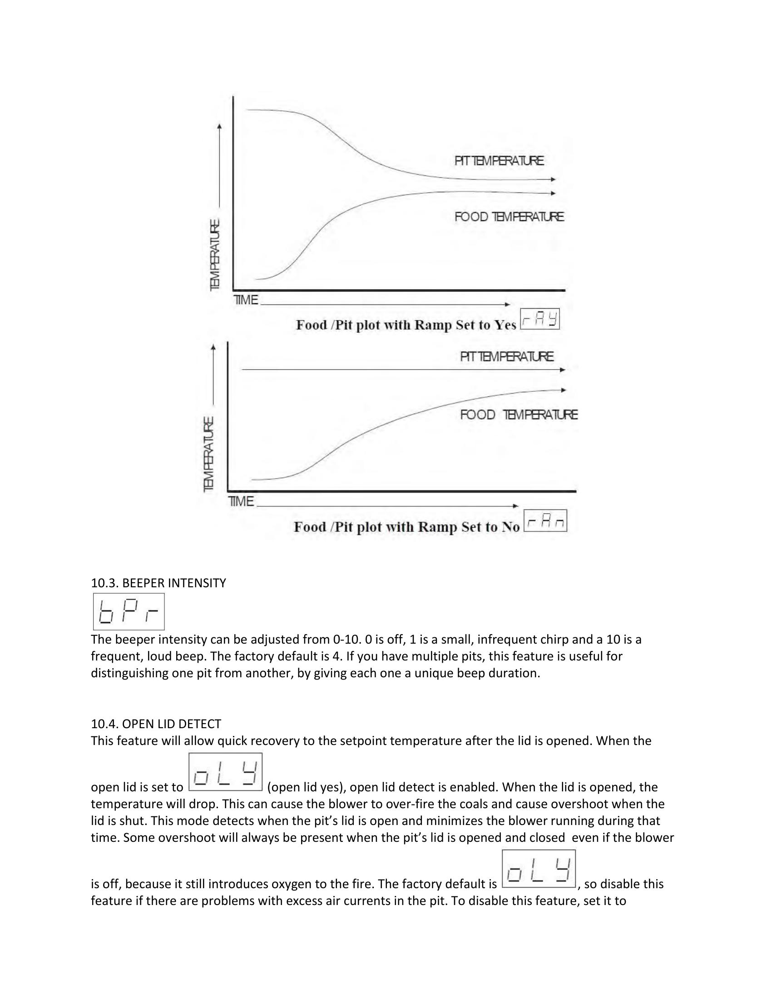


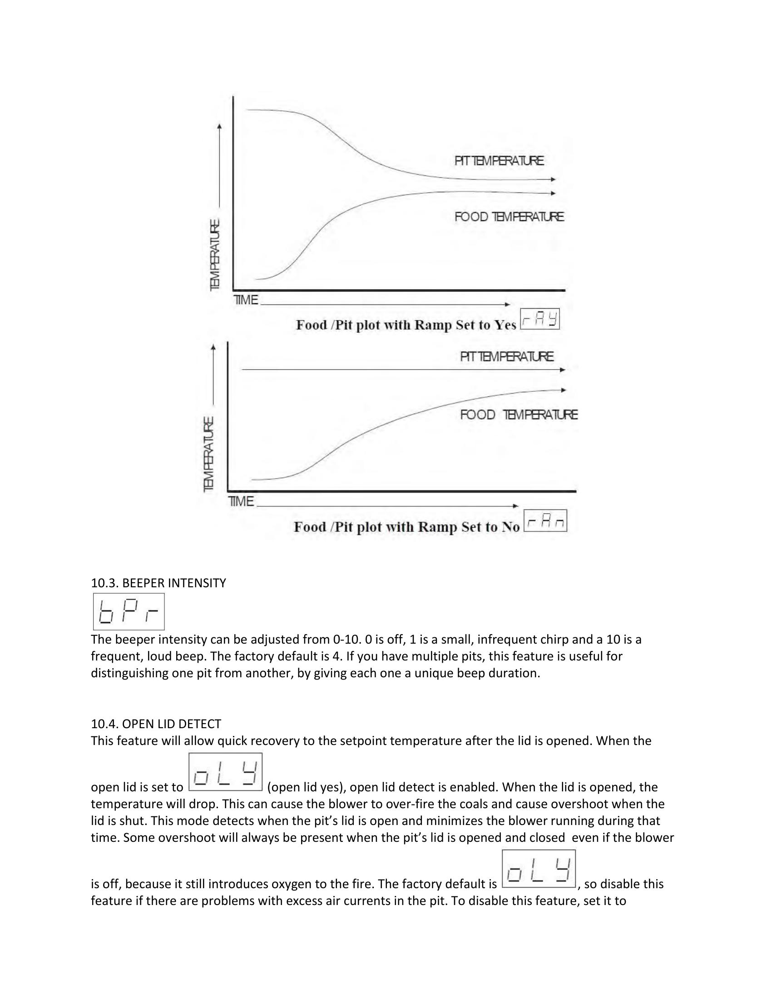

In [61]:
file=10
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 11


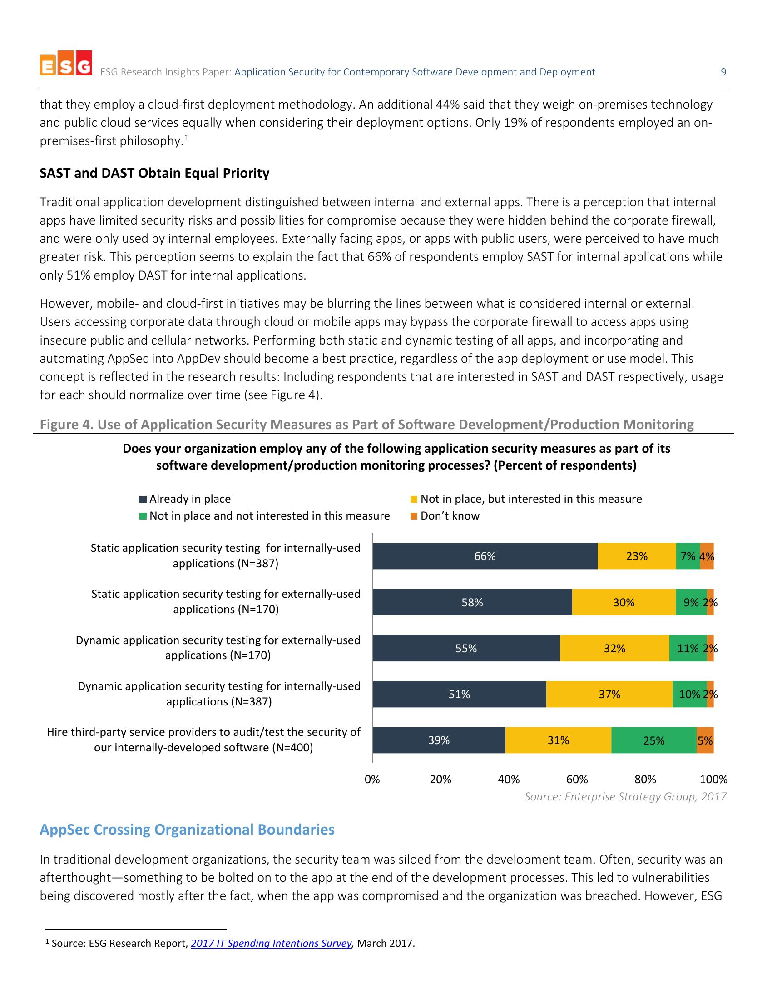


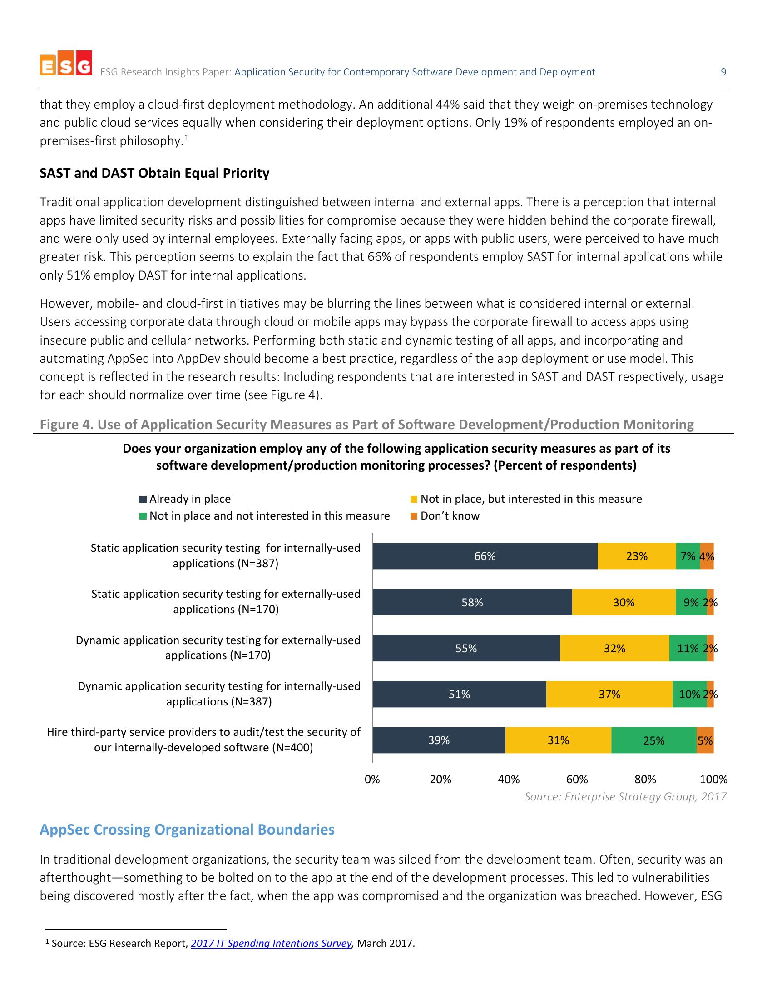


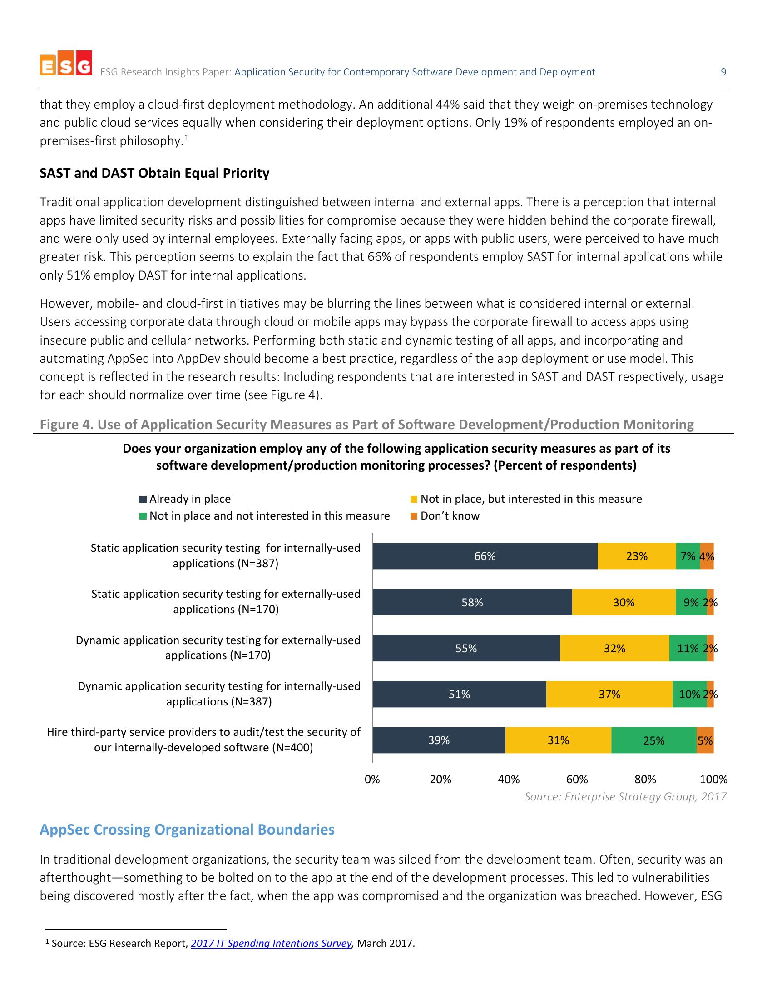

In [62]:
file=11
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 12


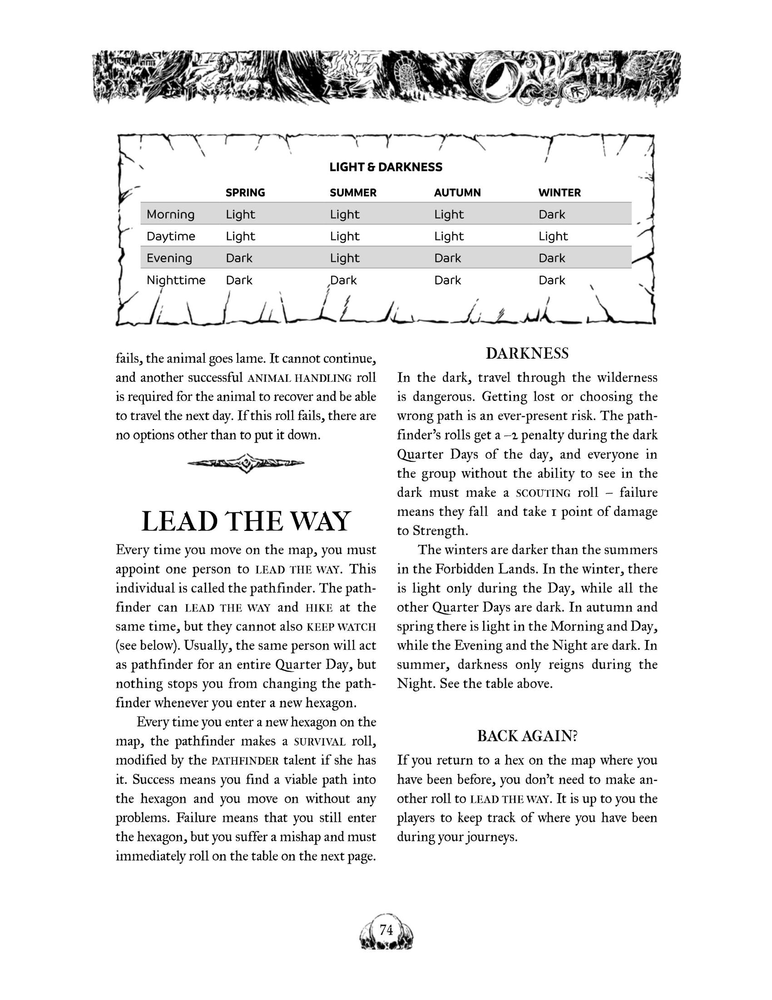


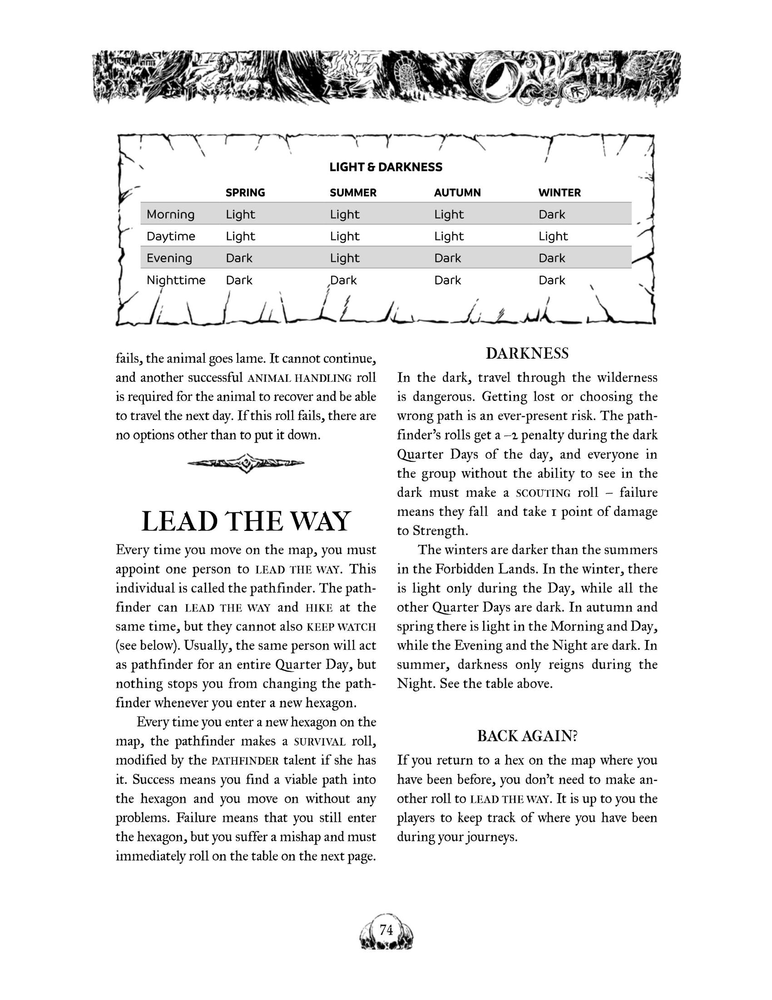


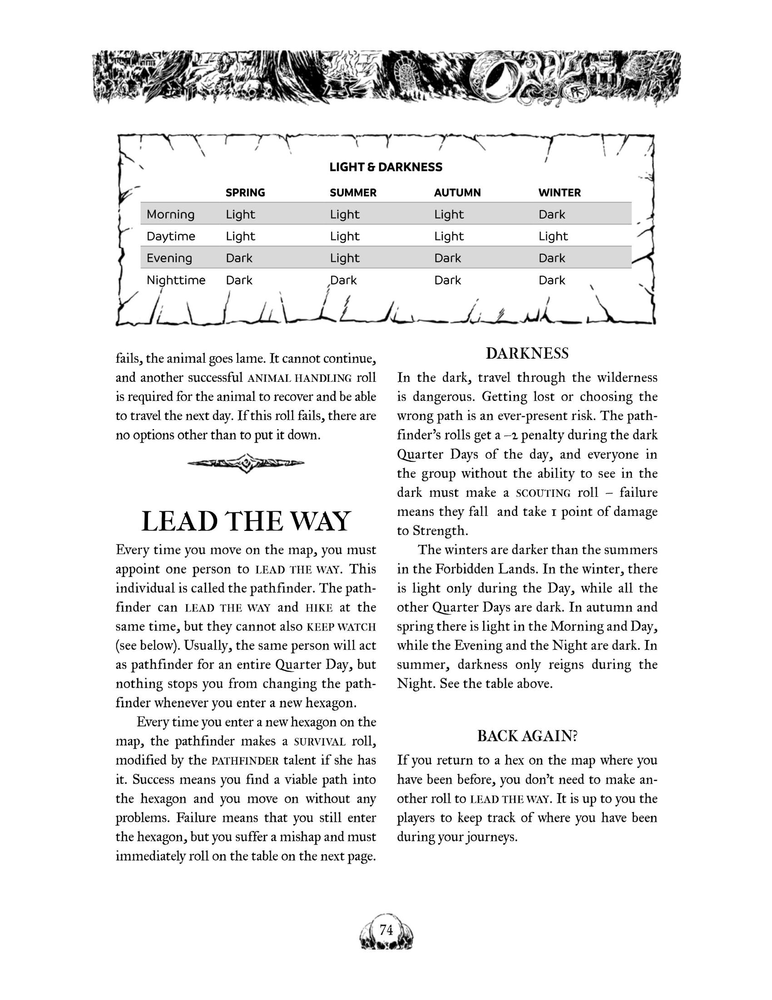

In [63]:
file=12
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 13


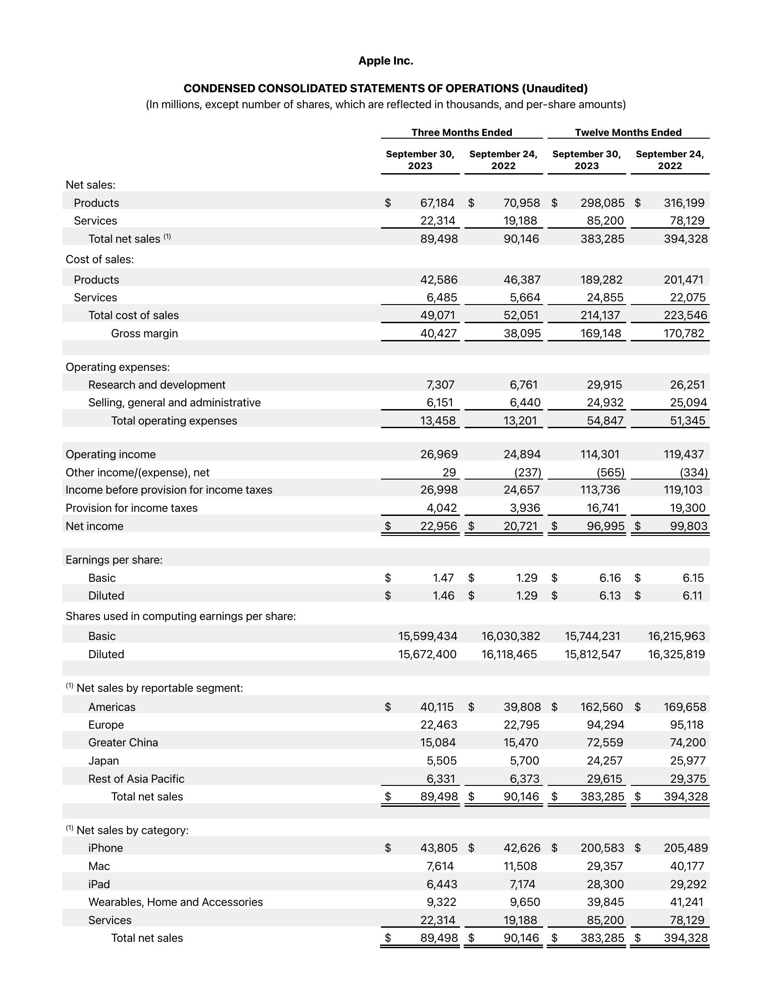


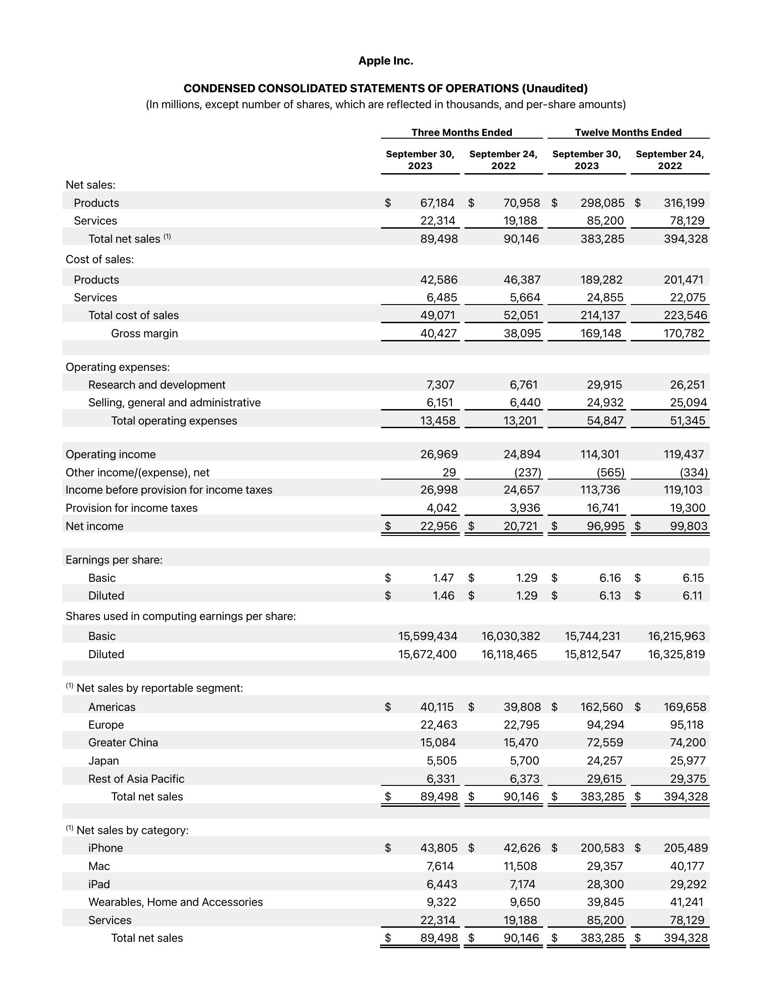


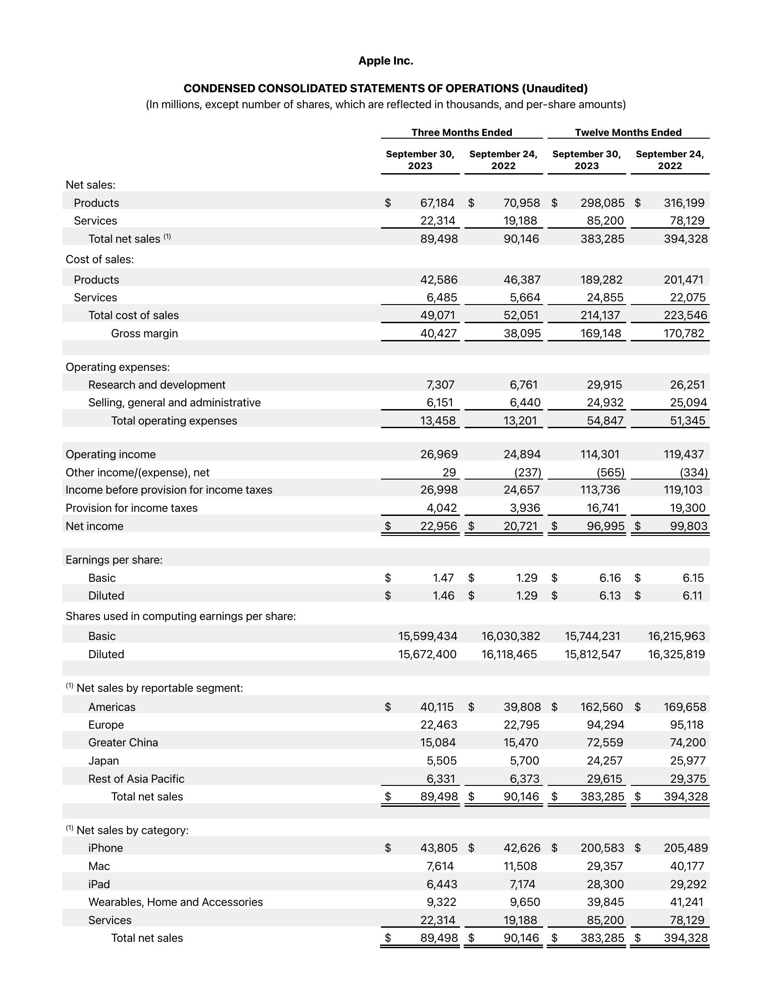

In [64]:
file=13
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 14


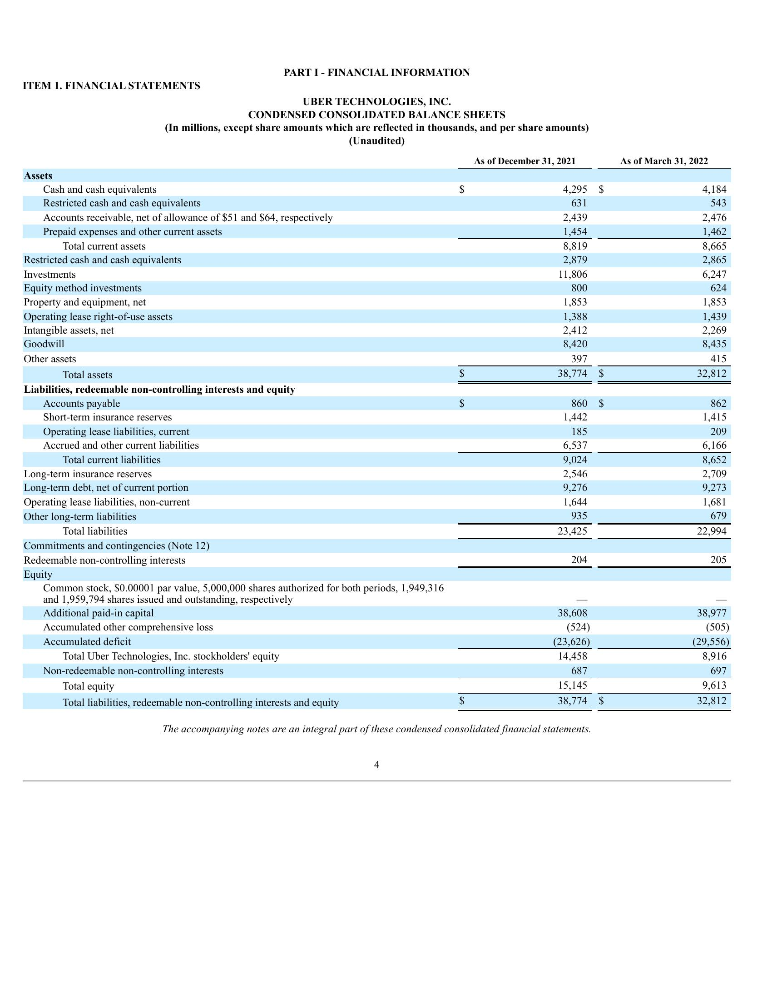


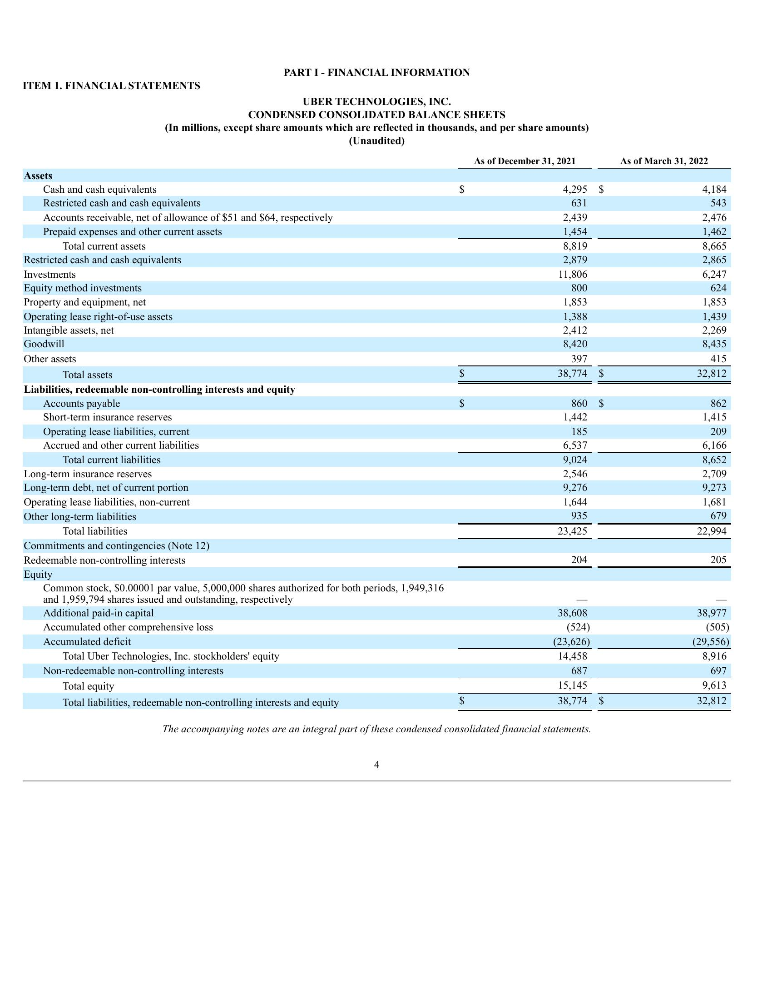


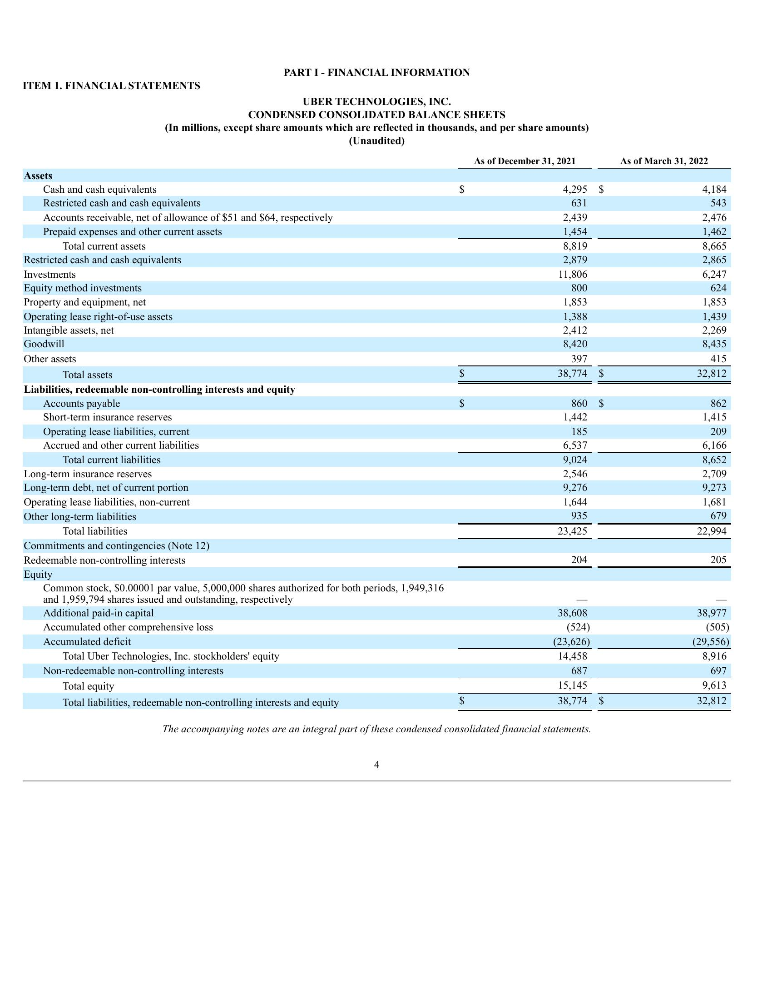

In [65]:
file=14
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

### sdfs

# Sample 15


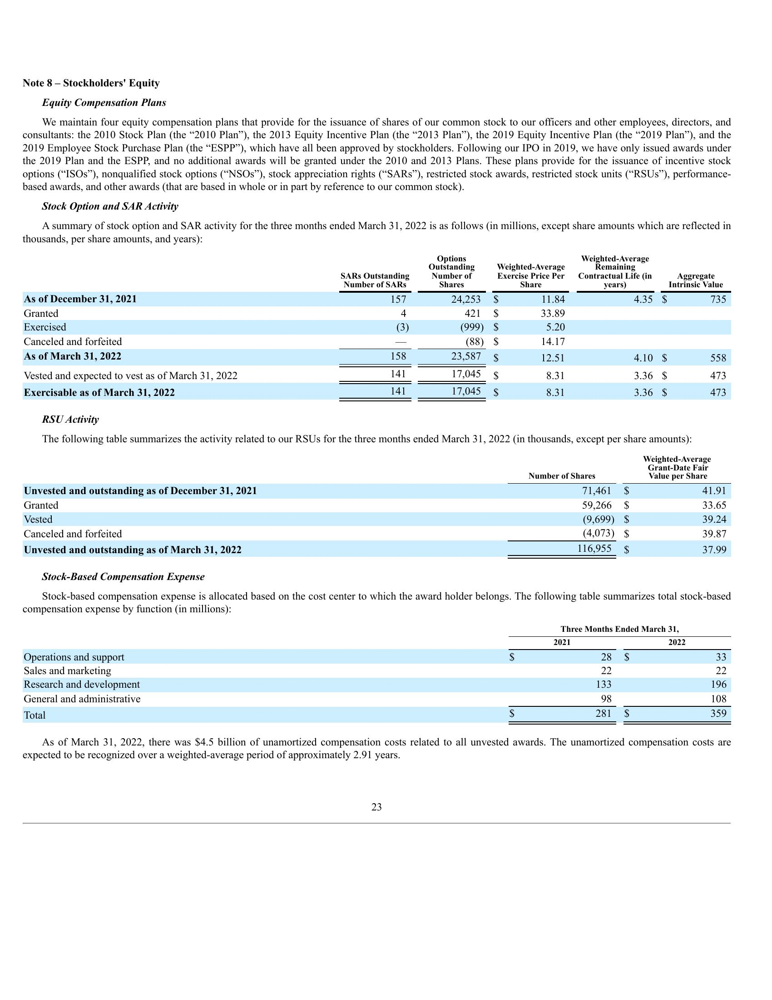


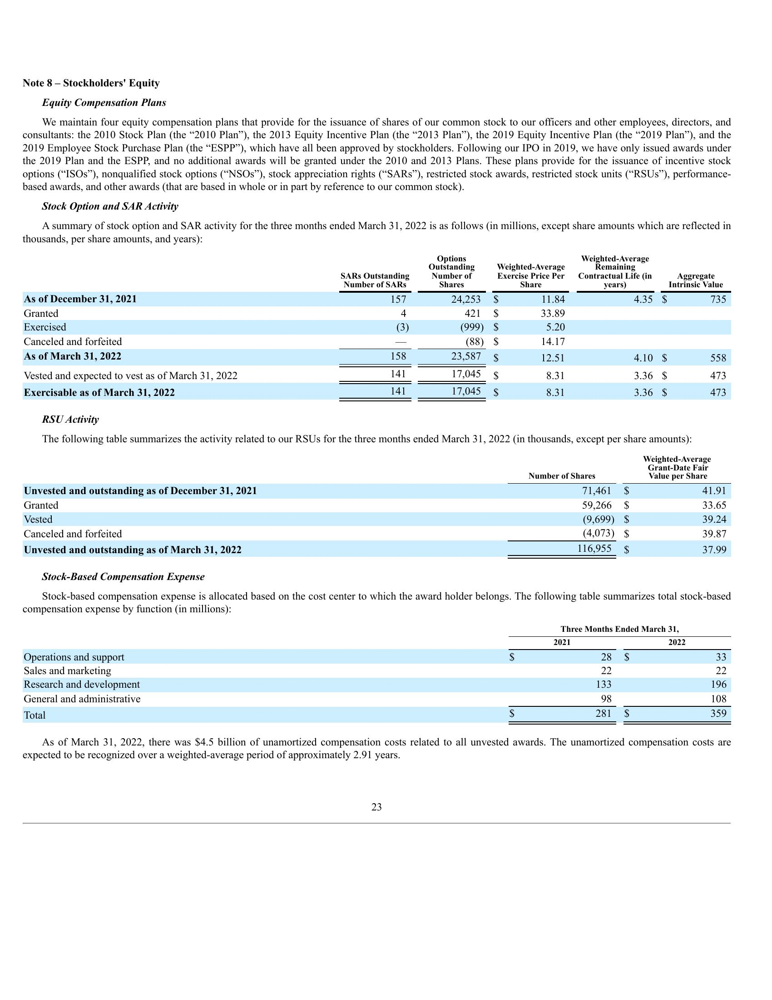


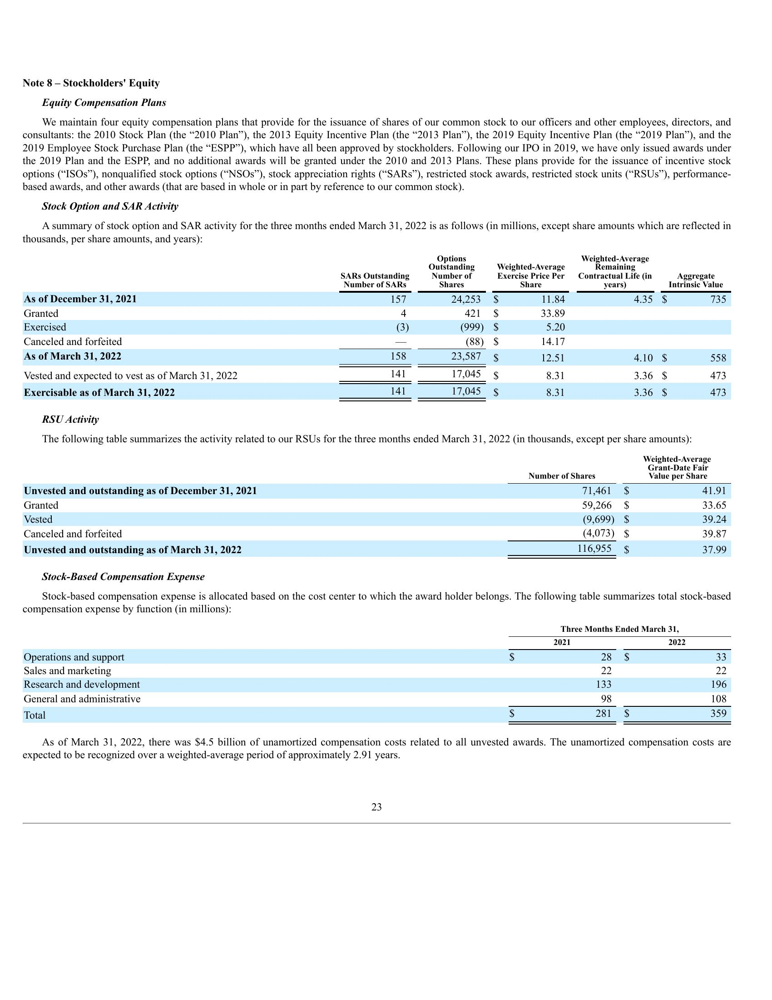

In [66]:
file=15
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/unstruct_result.txt', 'Unstructured')
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/llama_result.txt', 'LLamaParse' )
compare_pdf_extraction(f'./Data/{file}/original.pdf',f'./Data/{file}/graphlit_result.txt', 'Graphlit')

# Conclusion

- Explaination